In [44]:
import sys, os
import matplotlib.pyplot as plt
sys.path.append('../')
from sklearn.metrics import mean_squared_error
import re
import numpy as np

In [45]:
from core.models import rUNet
from core.utils.inference import inference_phase_rUNet_plot_notebook
from core.utils.data import define_dataset, select_dist

In [46]:
from functools import partial

In [47]:
import torch

In [48]:
%matplotlib inline

In [49]:
regex = re.compile(r'\d+')

In [100]:
saved_models = '/storage/yw18581/src/leaf_reco/saved_models/trained_6positions_multi_loss_augmentation/'

In [85]:
saved_models = '/storage/yw18581/src/leaf_reco/saved_models/trained_6positions_multi_loss_augmentation_gaus30/'

In [101]:
root_path = partial(os.path.join, saved_models)

In [102]:
data_folder = ('/storage/yw18581/data/dataset/')

In [103]:
model_names = os.listdir(saved_models)

In [104]:
def get_fnames(coeff, prefix='Trained'):
    idx_coef = 6 if prefix=='Trained' else 4
    idx_epoch = 5 if prefix =='Trained' else 3
    f_list = []
    epochs = []
    for fname in model_names:
        if fname.startswith(prefix):
            if regex.findall(fname.split("_")[idx_coef])[1]==str(coeff):
                epoch = int(regex.findall(fname.split("_")[idx_epoch])[0]) 
                epochs.append(epoch)
                if int(regex.findall(fname.split("_")[idx_epoch])[0])==epoch:
                    f_list.append(fname)
    
    return np.array(f_list)[np.argsort(epochs)], np.sort(epochs)

In [105]:
training_dist = [2,4,10,20,25,35]
unseen_dist = [1,3,15,30]

In [91]:
selected_distances = select_dist(data_folder, unseen_dist)

In [92]:
from core.utils.data.transformers import ChannelsFirst, Rescale, ToTensor, Crop, GaussianNoise, RandomCrop, Swap, \
        FlipUD, FlipLR

In [93]:
base_transformers = [Crop(row_slice=slice(0,1400), col_slice=slice(1000,None)),
                           Rescale(scale=0.25), ChannelsFirst(),ToTensor()]

In [94]:
base_transfofrmers_2 = [RandomCrop(p=1), Swap(p=0.7), FlipLR(p=0.7), FlipUD(p=0.7),
                        Rescale(0.25), ChannelsFirst(),ToTensor()]

In [95]:
train_transformers = [RandomCrop(p=1), Swap(p=0.7), FlipLR(p=0.7), FlipUD(p=0.7),
                      GaussianNoise(p=0.75, sigma=10), Rescale(0.25), ChannelsFirst(),ToTensor()]

In [96]:
data_loaders, data_length = define_dataset(root_folder=data_folder, base_transformers=base_transformers,
                                           train_transformers=train_transformers,
                                           batch_size=16, include_list=selected_distances,
                                            alldata=True, multi_processing=4)

In [97]:
data_length

3532

In [98]:
def predict_coef_epoch(coeff, epoch):
    filelist, epochs = get_fnames(coeff)
    model_fname = filelist[int(np.argwhere(epochs==epoch)[0])]
    print(model_fname)
    torch.cuda.empty_cache()
    model = rUNet(out_size=1)
    checkpoint = torch.load(root_path(model_fname))['model_state_dict']
    #print(checkpoint)
    model.load_state_dict(checkpoint)
    
    print('Checkpoint loaded')
    inference_phase_rUNet_plot_notebook(model, data_loaders, data_length,
                                       batch_size=16, stop=1, test=False)

    return

Trained_rUNet_pytorch_6positions_dataset_110epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [14.261622]


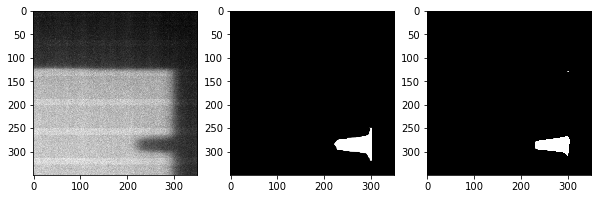

2: true_dist: 15, pred_dist: [15.133215]


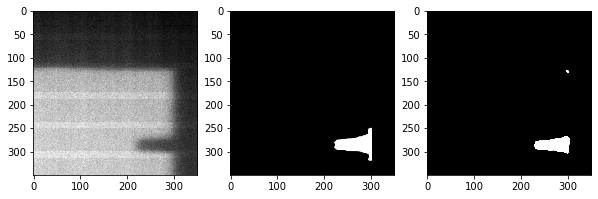

3: true_dist: 15, pred_dist: [17.119652]


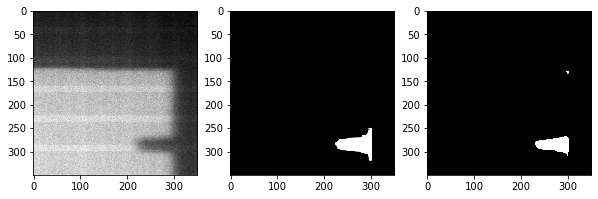

4: true_dist: 15, pred_dist: [15.606984]


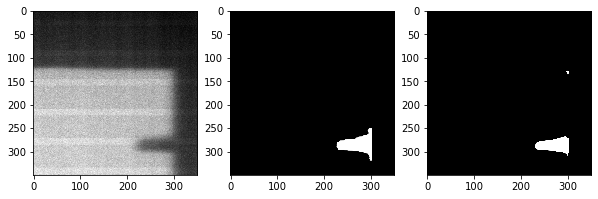

5: true_dist: 15, pred_dist: [14.458717]


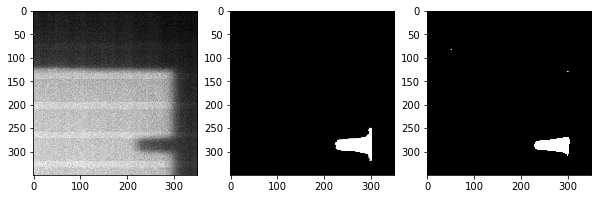

6: true_dist: 15, pred_dist: [13.636175]


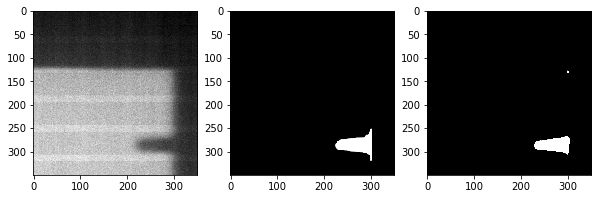

7: true_dist: 15, pred_dist: [15.859275]


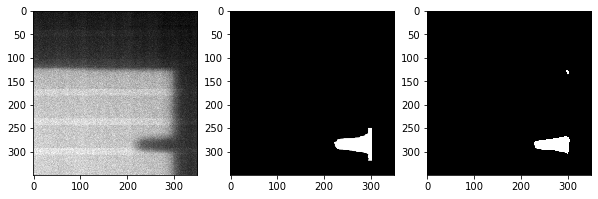

8: true_dist: 15, pred_dist: [15.861246]


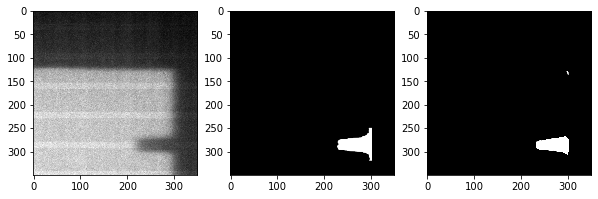

9: true_dist: 15, pred_dist: [14.29721]


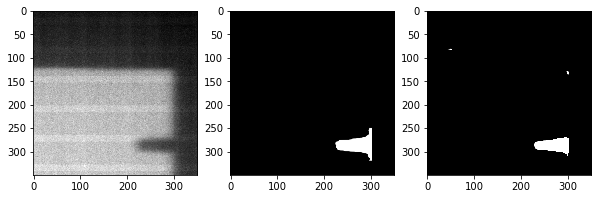

10: true_dist: 15, pred_dist: [13.750292]


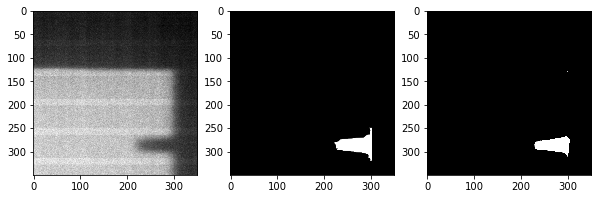

11: true_dist: 15, pred_dist: [13.691926]


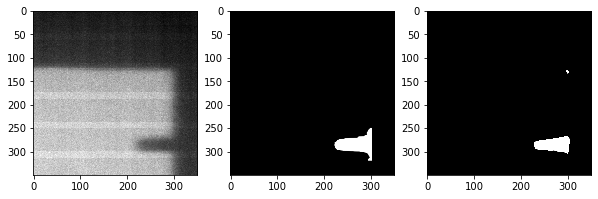

12: true_dist: 15, pred_dist: [16.75516]


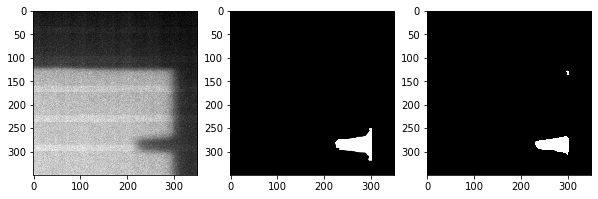

13: true_dist: 15, pred_dist: [15.06336]


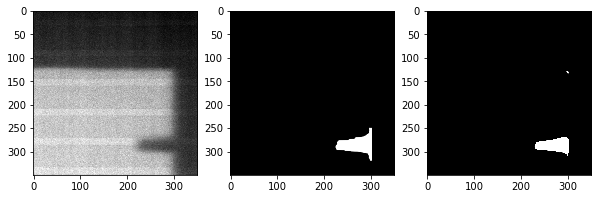

14: true_dist: 15, pred_dist: [13.863981]


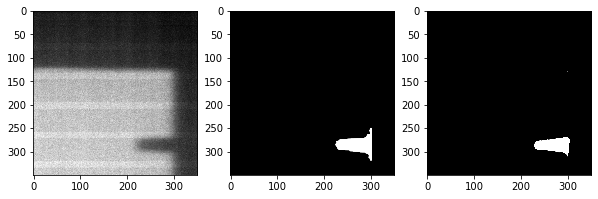

15: true_dist: 15, pred_dist: [12.74061]


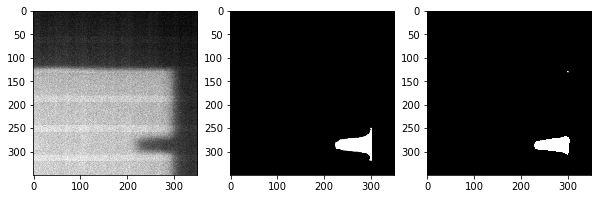

16: true_dist: 15, pred_dist: [15.858642]


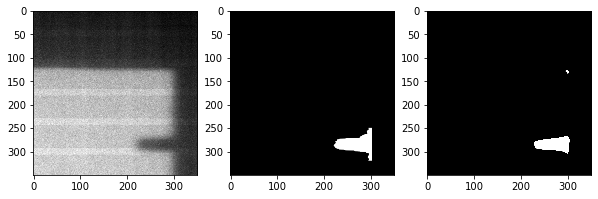

batch 2
1: true_dist: 15, pred_dist: [15.952764]


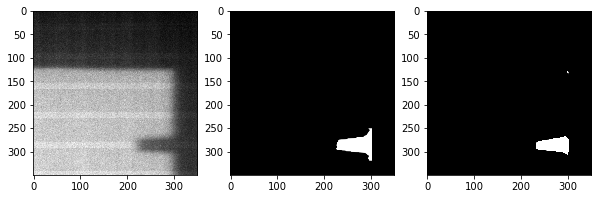

2: true_dist: 15, pred_dist: [14.5815325]


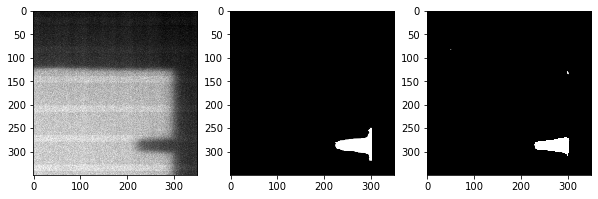

3: true_dist: 15, pred_dist: [13.557137]


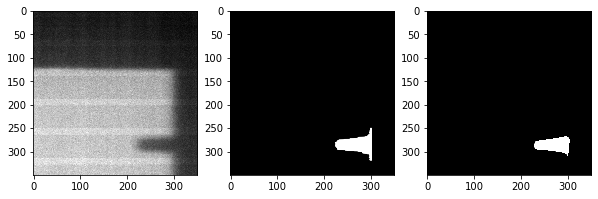

4: true_dist: 15, pred_dist: [13.694022]


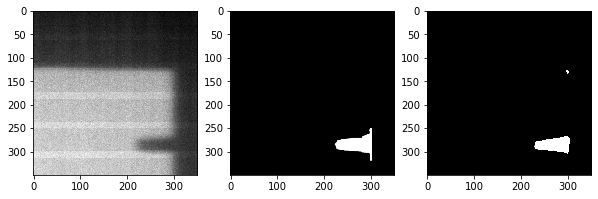

5: true_dist: 15, pred_dist: [17.071733]


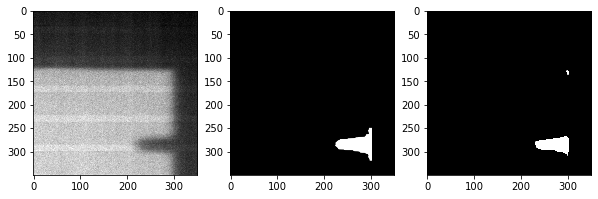

6: true_dist: 15, pred_dist: [15.2479105]


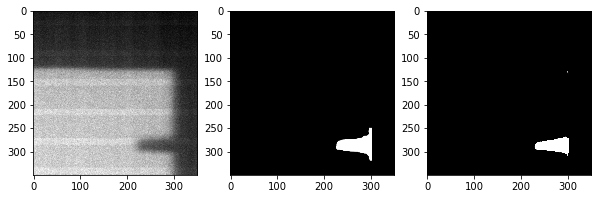

7: true_dist: 15, pred_dist: [13.979591]


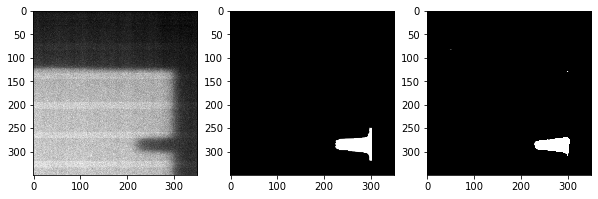

8: true_dist: 15, pred_dist: [13.749647]


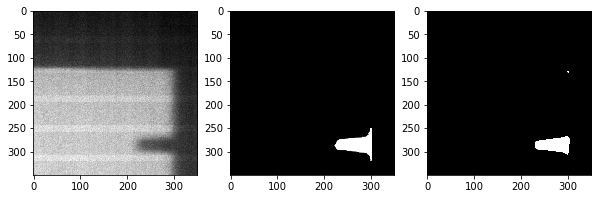

9: true_dist: 15, pred_dist: [16.200974]


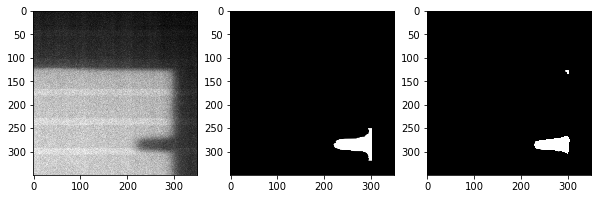

10: true_dist: 15, pred_dist: [16.658258]


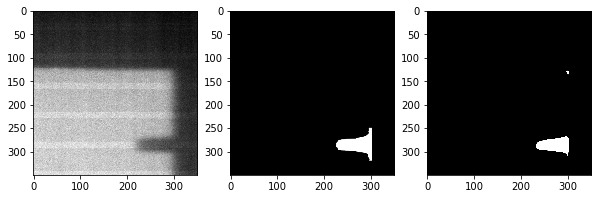

11: true_dist: 15, pred_dist: [14.944213]


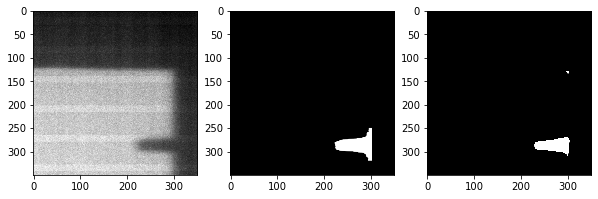

12: true_dist: 15, pred_dist: [14.084085]


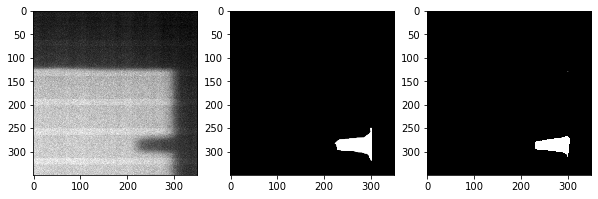

13: true_dist: 15, pred_dist: [14.616978]


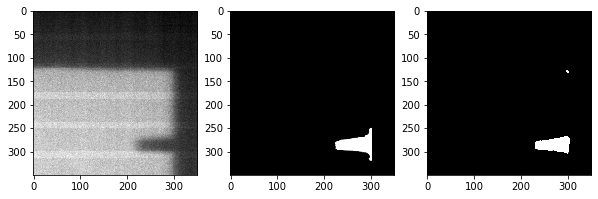

14: true_dist: 15, pred_dist: [16.538176]


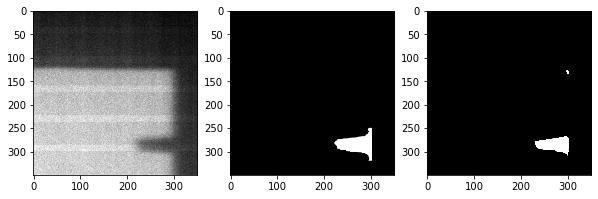

15: true_dist: 15, pred_dist: [15.845408]


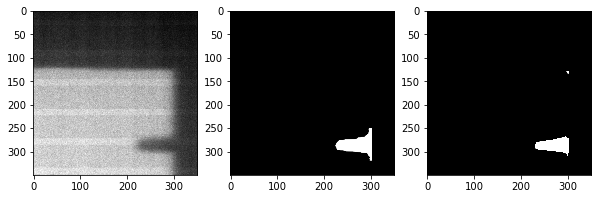

16: true_dist: 15, pred_dist: [14.987132]


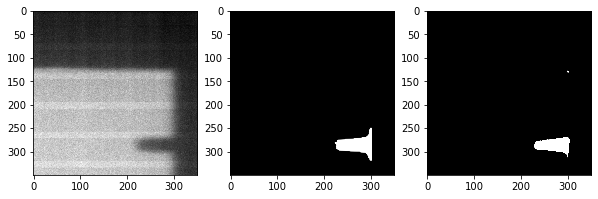

Trained_rUNet_pytorch_6positions_dataset_120epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [14.91523]


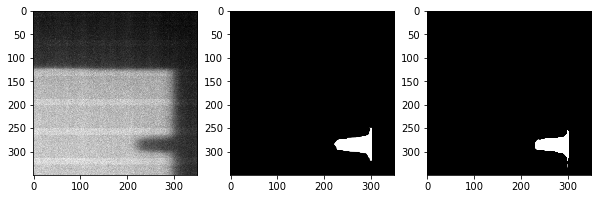

2: true_dist: 15, pred_dist: [15.178497]


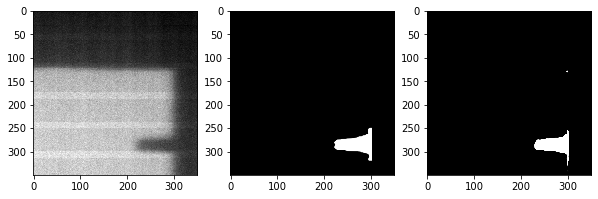

3: true_dist: 15, pred_dist: [15.94585]


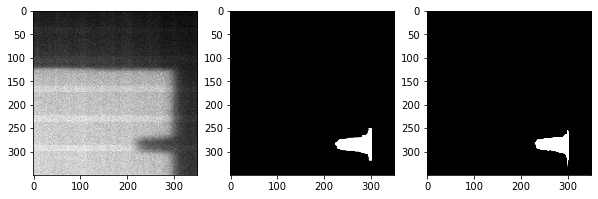

4: true_dist: 15, pred_dist: [15.489385]


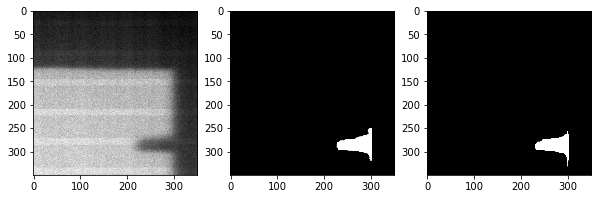

5: true_dist: 15, pred_dist: [14.987135]


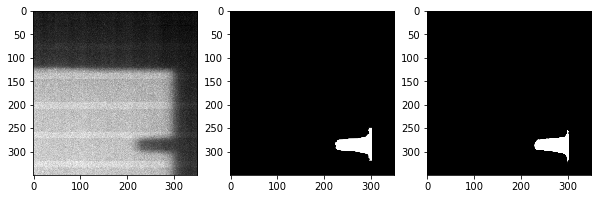

6: true_dist: 15, pred_dist: [14.350618]


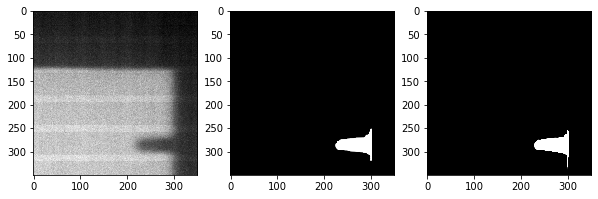

7: true_dist: 15, pred_dist: [15.217188]


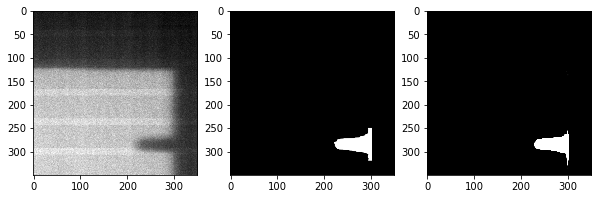

8: true_dist: 15, pred_dist: [15.727721]


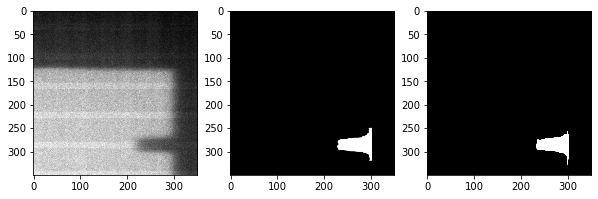

9: true_dist: 15, pred_dist: [14.898269]


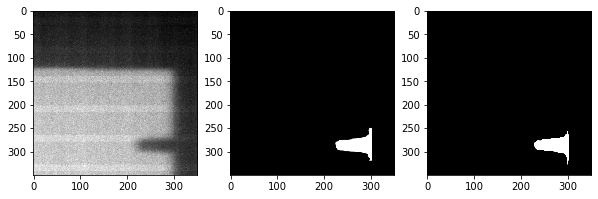

10: true_dist: 15, pred_dist: [14.583376]


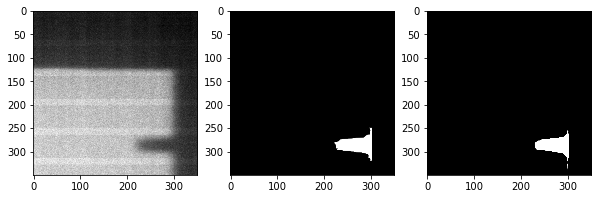

11: true_dist: 15, pred_dist: [14.212273]


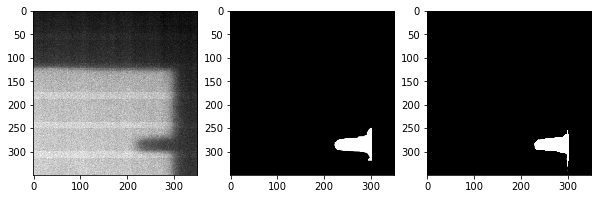

12: true_dist: 15, pred_dist: [15.899431]


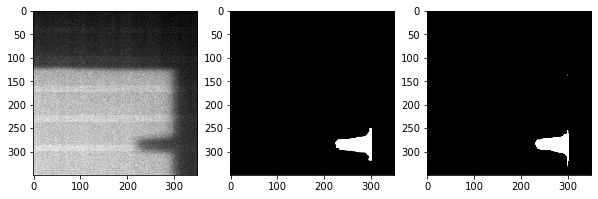

13: true_dist: 15, pred_dist: [15.395395]


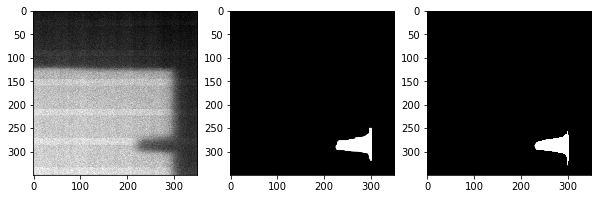

14: true_dist: 15, pred_dist: [14.586678]


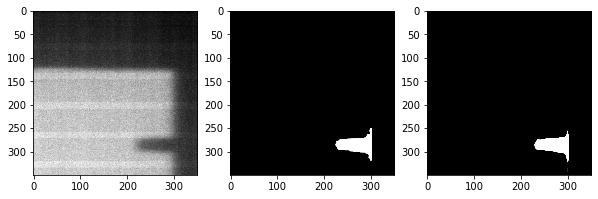

15: true_dist: 15, pred_dist: [13.955216]


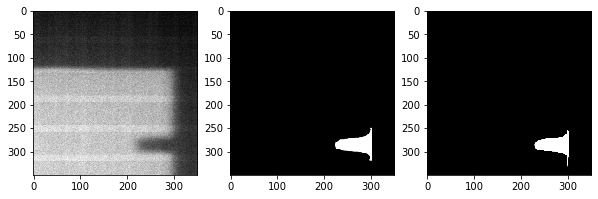

16: true_dist: 15, pred_dist: [15.246422]


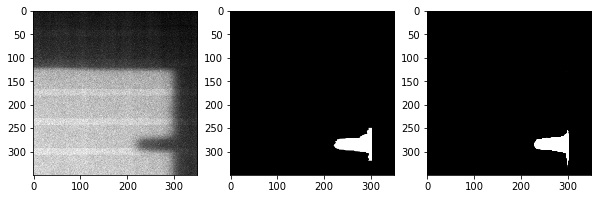

batch 2
1: true_dist: 15, pred_dist: [15.863758]


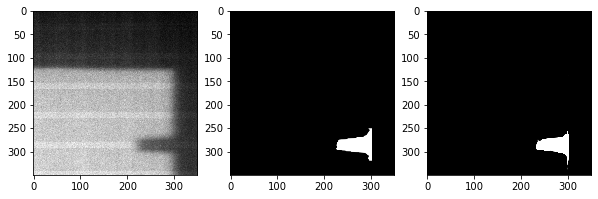

2: true_dist: 15, pred_dist: [15.030497]


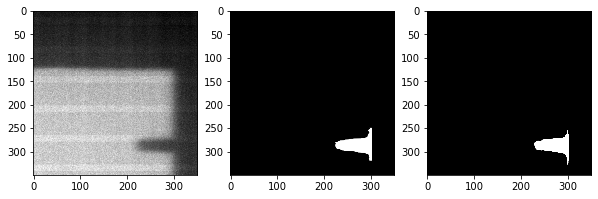

3: true_dist: 15, pred_dist: [14.508406]


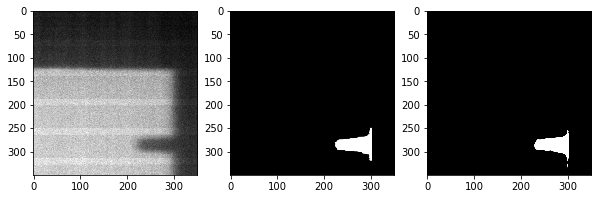

4: true_dist: 15, pred_dist: [14.180117]


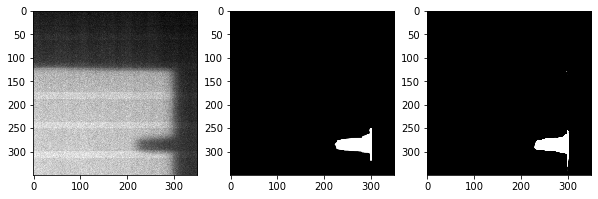

5: true_dist: 15, pred_dist: [16.149073]


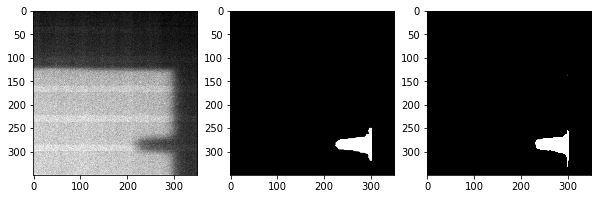

6: true_dist: 15, pred_dist: [15.403575]


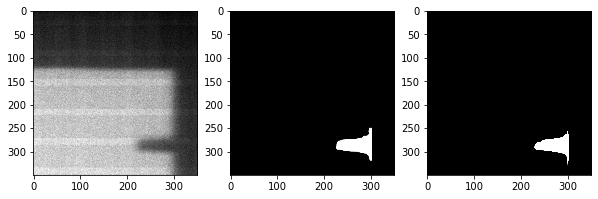

7: true_dist: 15, pred_dist: [14.692398]


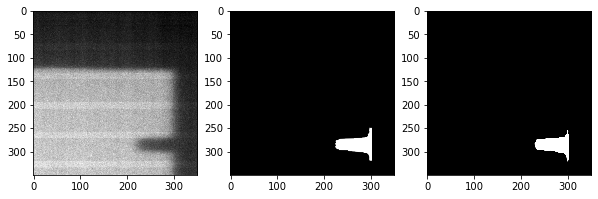

8: true_dist: 15, pred_dist: [14.386685]


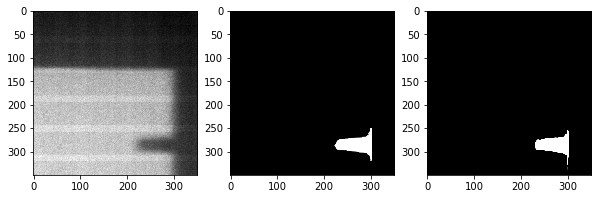

9: true_dist: 15, pred_dist: [15.325752]


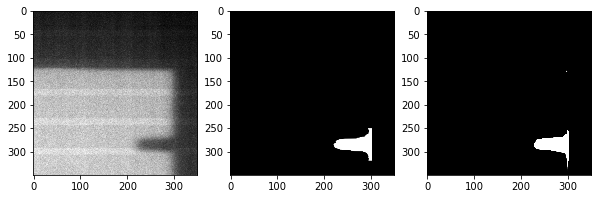

10: true_dist: 15, pred_dist: [16.093893]


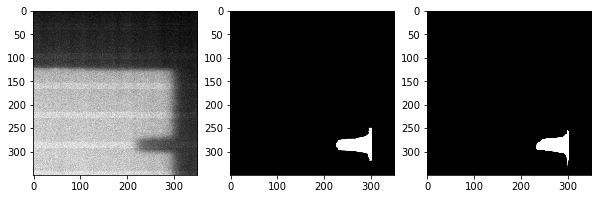

11: true_dist: 15, pred_dist: [15.3792925]


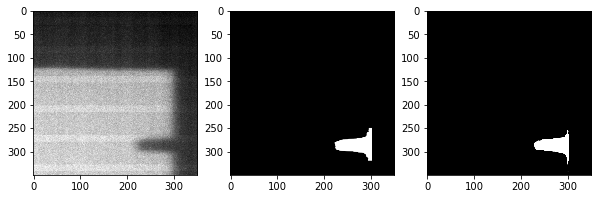

12: true_dist: 15, pred_dist: [14.71977]


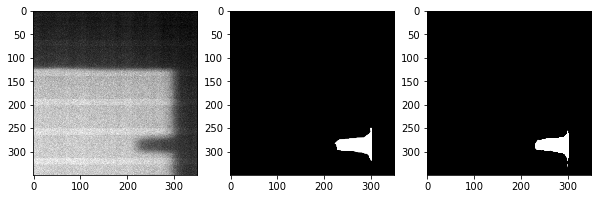

13: true_dist: 15, pred_dist: [14.758745]


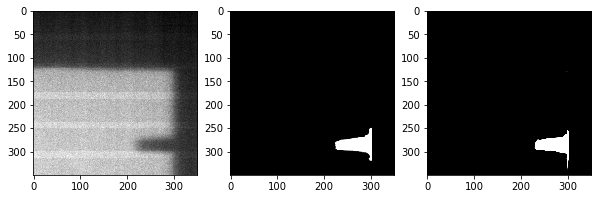

14: true_dist: 15, pred_dist: [15.711401]


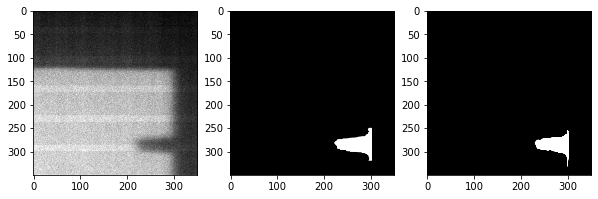

15: true_dist: 15, pred_dist: [15.760941]


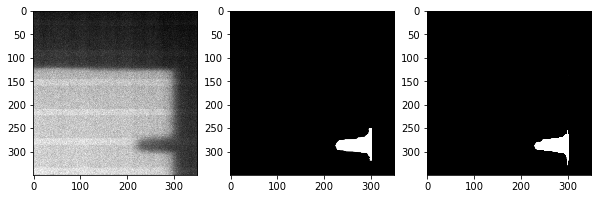

16: true_dist: 15, pred_dist: [15.3691]


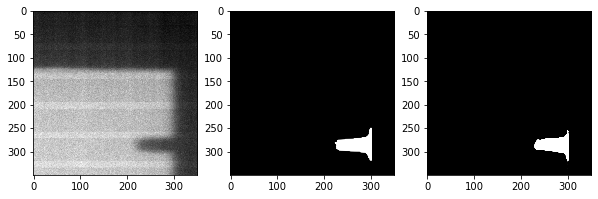

Trained_rUNet_pytorch_6positions_dataset_130epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [15.279676]


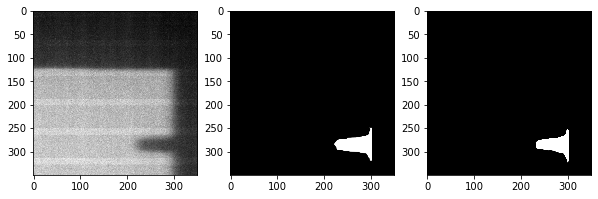

2: true_dist: 15, pred_dist: [15.386989]


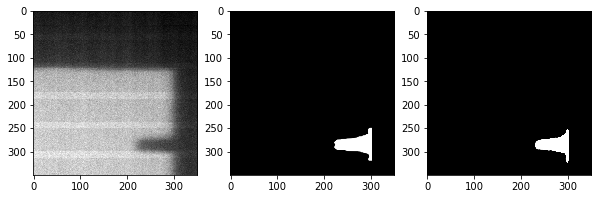

3: true_dist: 15, pred_dist: [15.714272]


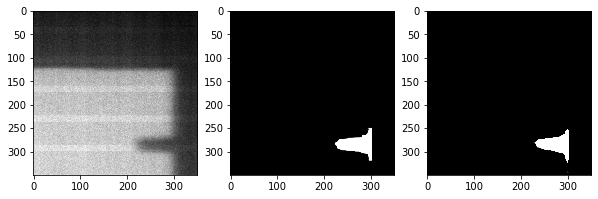

4: true_dist: 15, pred_dist: [15.467882]


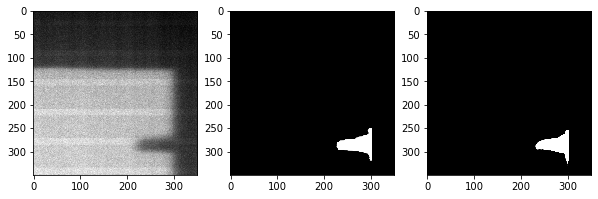

5: true_dist: 15, pred_dist: [15.287439]


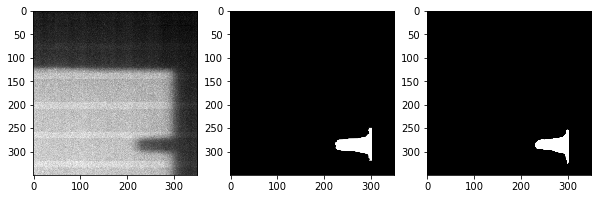

6: true_dist: 15, pred_dist: [14.984852]


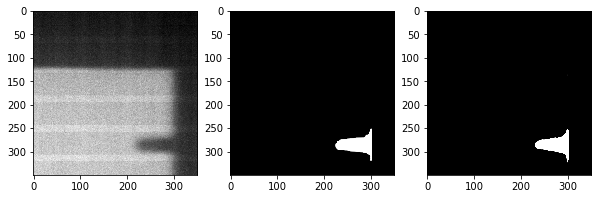

7: true_dist: 15, pred_dist: [15.196654]


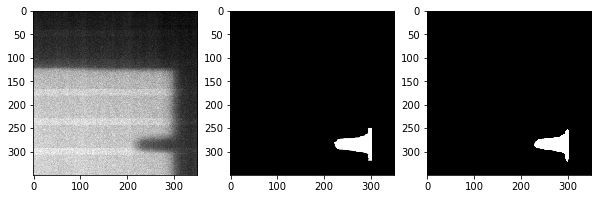

8: true_dist: 15, pred_dist: [15.602833]


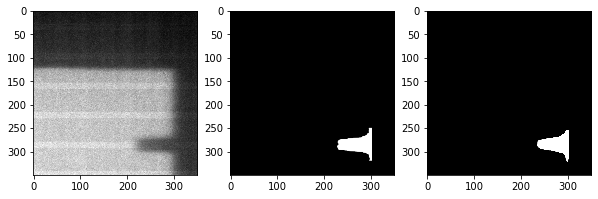

9: true_dist: 15, pred_dist: [15.156112]


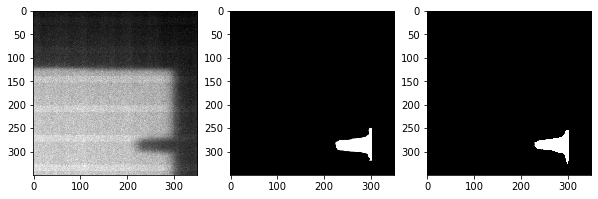

10: true_dist: 15, pred_dist: [15.13277]


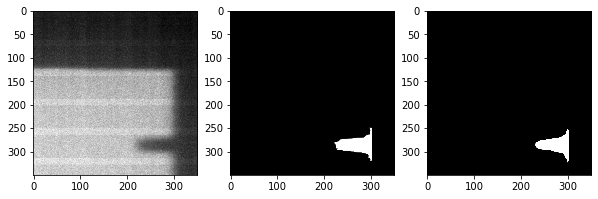

11: true_dist: 15, pred_dist: [14.849824]


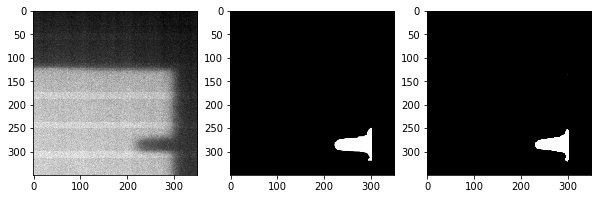

12: true_dist: 15, pred_dist: [15.659783]


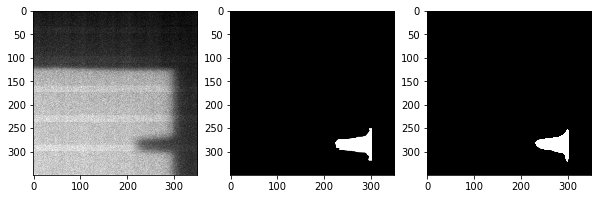

13: true_dist: 15, pred_dist: [15.438083]


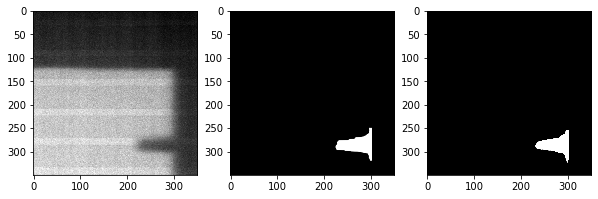

14: true_dist: 15, pred_dist: [15.0871725]


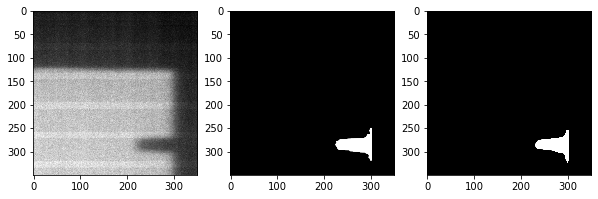

15: true_dist: 15, pred_dist: [14.7848835]


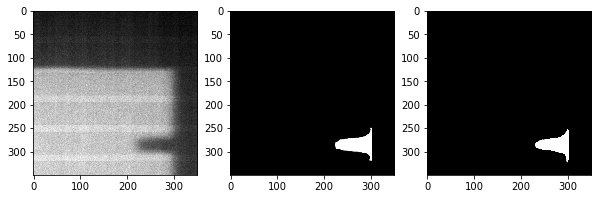

16: true_dist: 15, pred_dist: [15.20684]


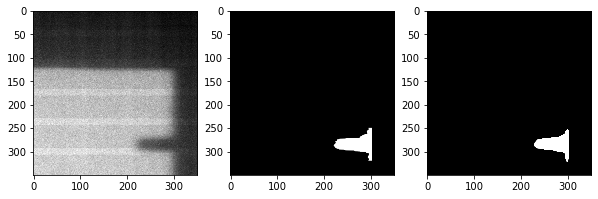

batch 2
1: true_dist: 15, pred_dist: [15.837017]


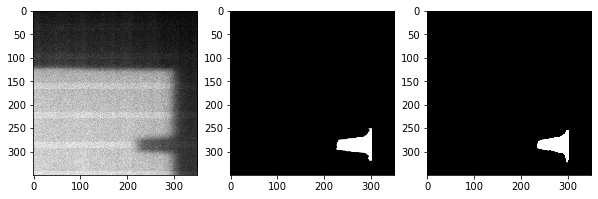

2: true_dist: 15, pred_dist: [15.246985]


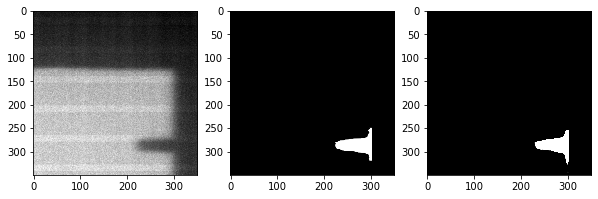

3: true_dist: 15, pred_dist: [15.08839]


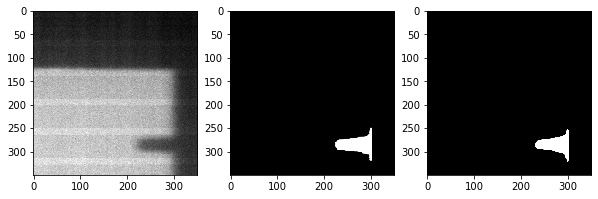

4: true_dist: 15, pred_dist: [14.763232]


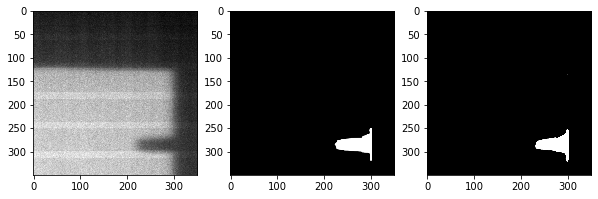

5: true_dist: 15, pred_dist: [15.855314]


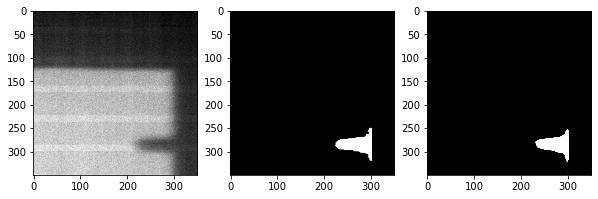

6: true_dist: 15, pred_dist: [15.444887]


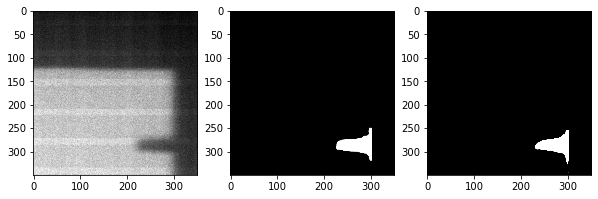

7: true_dist: 15, pred_dist: [15.103265]


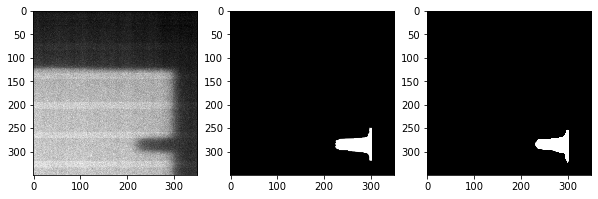

8: true_dist: 15, pred_dist: [14.997564]


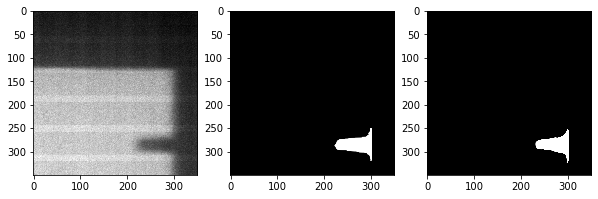

9: true_dist: 15, pred_dist: [15.242287]


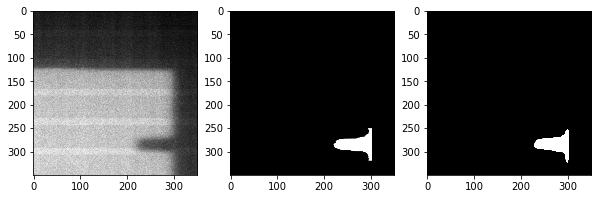

10: true_dist: 15, pred_dist: [15.975867]


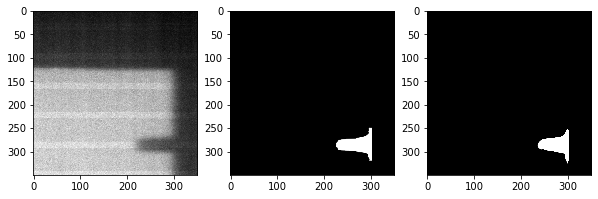

11: true_dist: 15, pred_dist: [15.428578]


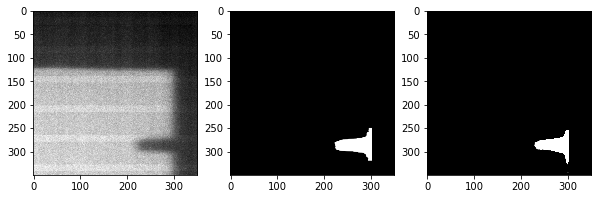

12: true_dist: 15, pred_dist: [15.231518]


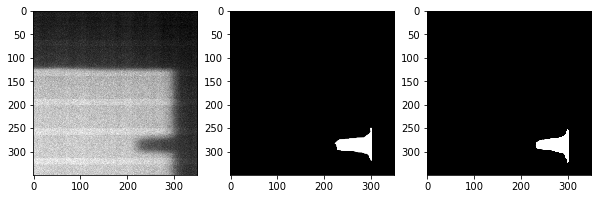

13: true_dist: 15, pred_dist: [15.121071]


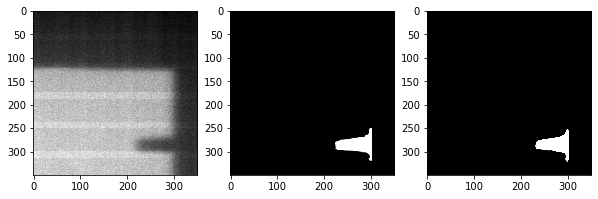

14: true_dist: 15, pred_dist: [15.567877]


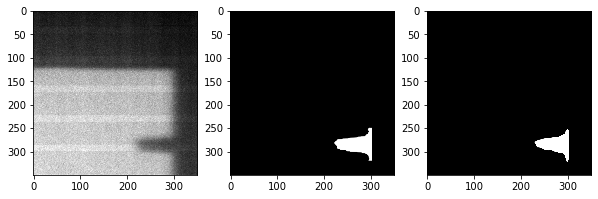

15: true_dist: 15, pred_dist: [15.6716585]


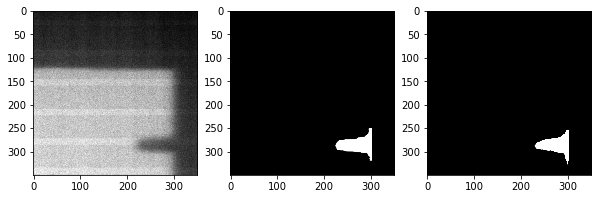

16: true_dist: 15, pred_dist: [15.513782]


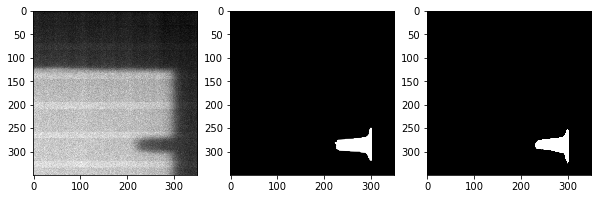

Trained_rUNet_pytorch_6positions_dataset_140epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [15.370565]


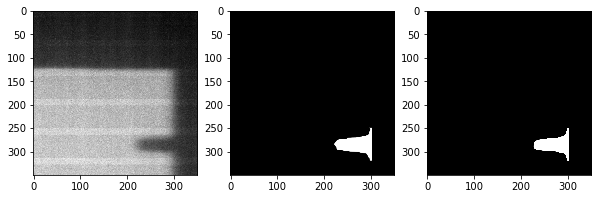

2: true_dist: 15, pred_dist: [15.3455]


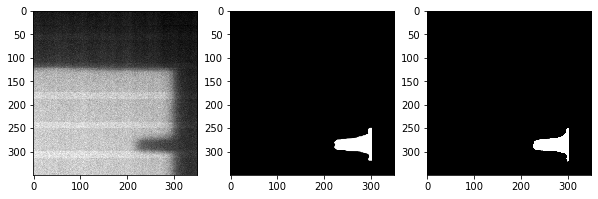

3: true_dist: 15, pred_dist: [15.467305]


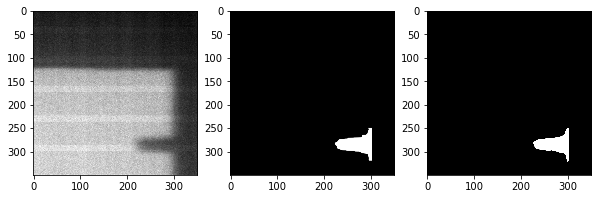

4: true_dist: 15, pred_dist: [15.426393]


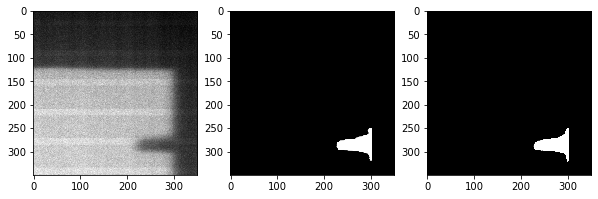

5: true_dist: 15, pred_dist: [15.340294]


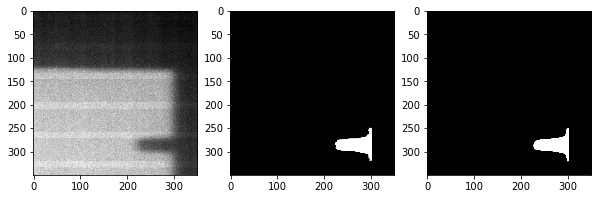

6: true_dist: 15, pred_dist: [15.101759]


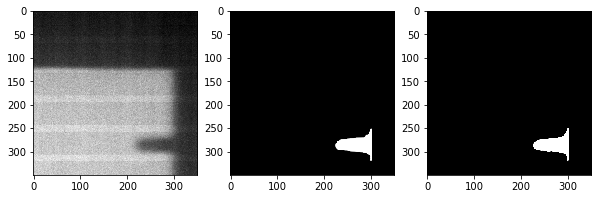

7: true_dist: 15, pred_dist: [15.100931]


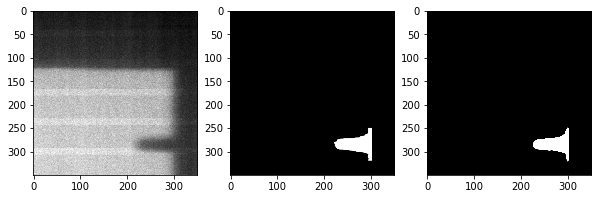

8: true_dist: 15, pred_dist: [15.5306015]


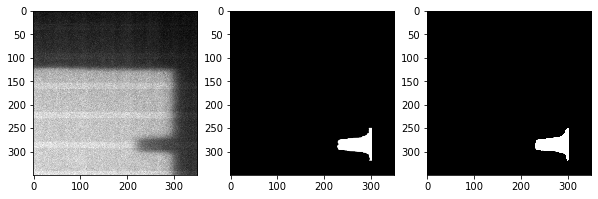

9: true_dist: 15, pred_dist: [15.200671]


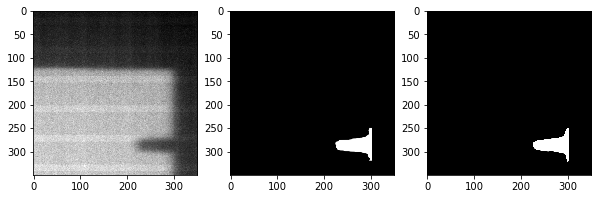

10: true_dist: 15, pred_dist: [15.206848]


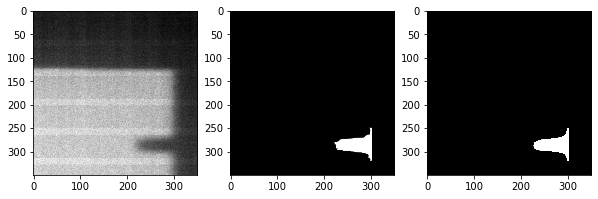

11: true_dist: 15, pred_dist: [14.954086]


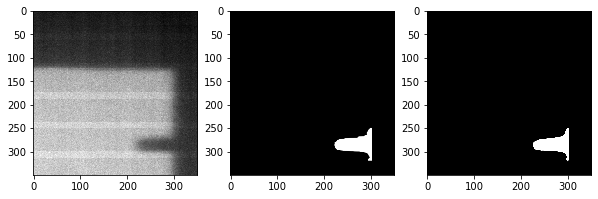

12: true_dist: 15, pred_dist: [15.441695]


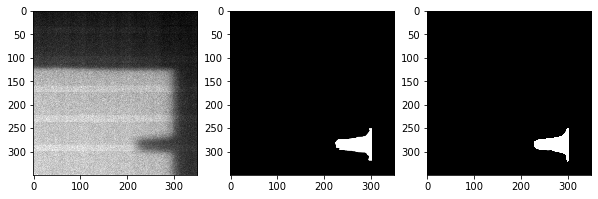

13: true_dist: 15, pred_dist: [15.41042]


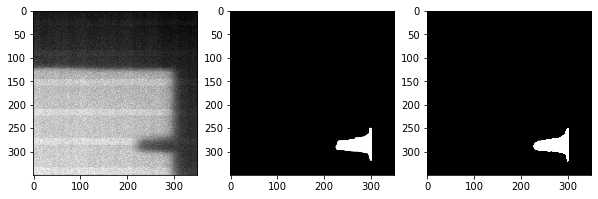

14: true_dist: 15, pred_dist: [15.184348]


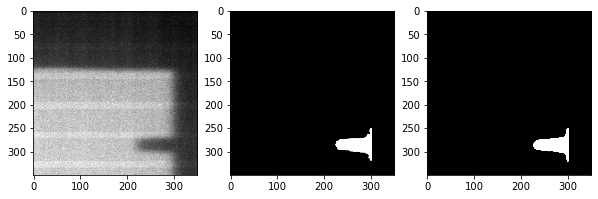

15: true_dist: 15, pred_dist: [14.928964]


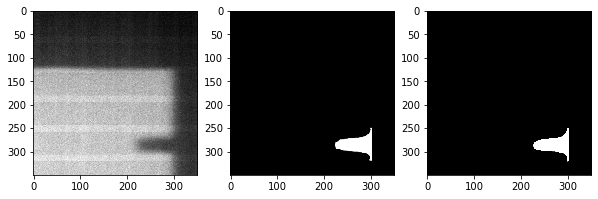

16: true_dist: 15, pred_dist: [15.131887]


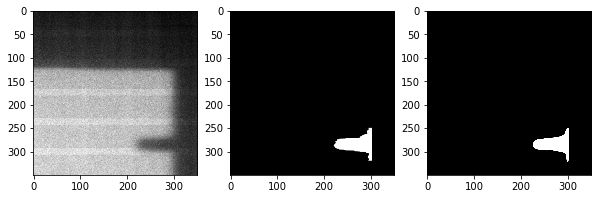

batch 2
1: true_dist: 15, pred_dist: [15.695062]


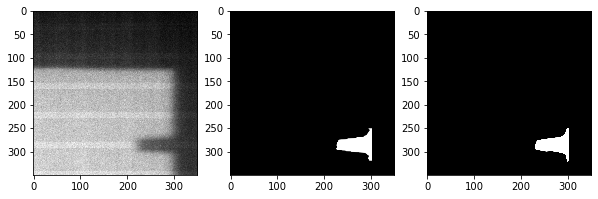

2: true_dist: 15, pred_dist: [15.253805]


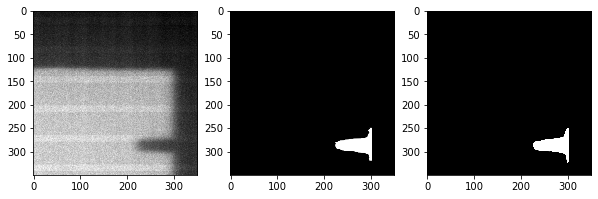

3: true_dist: 15, pred_dist: [15.202079]


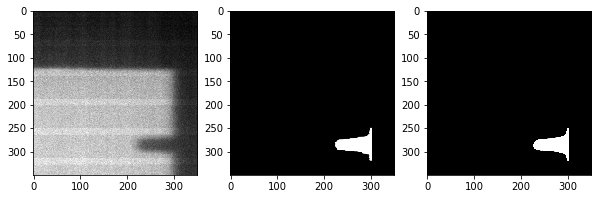

4: true_dist: 15, pred_dist: [14.848736]


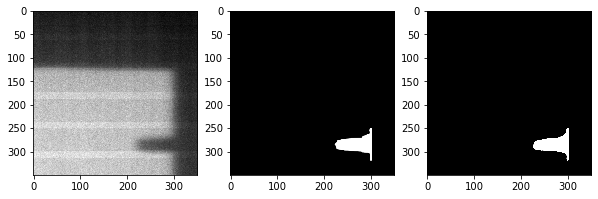

5: true_dist: 15, pred_dist: [15.612878]


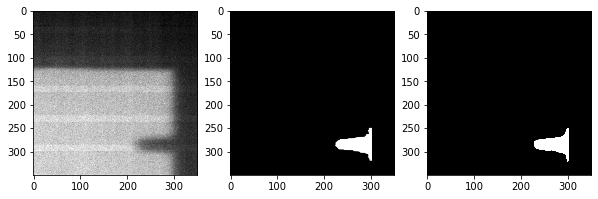

6: true_dist: 15, pred_dist: [15.382695]


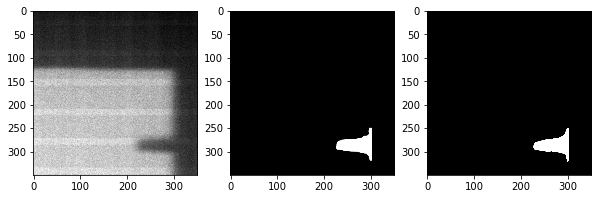

7: true_dist: 15, pred_dist: [15.206018]


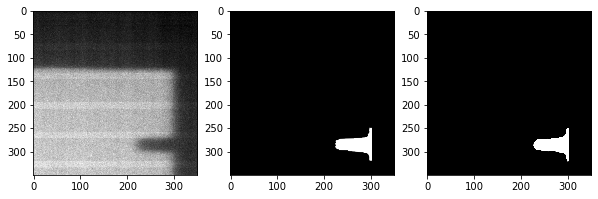

8: true_dist: 15, pred_dist: [15.162142]


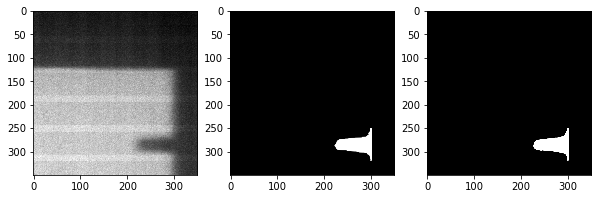

9: true_dist: 15, pred_dist: [15.1339035]


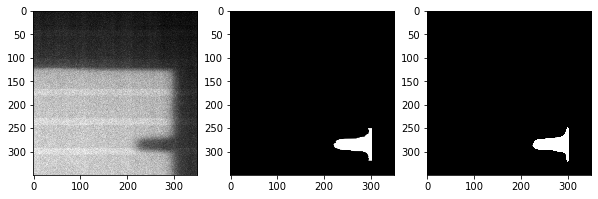

10: true_dist: 15, pred_dist: [15.71395]


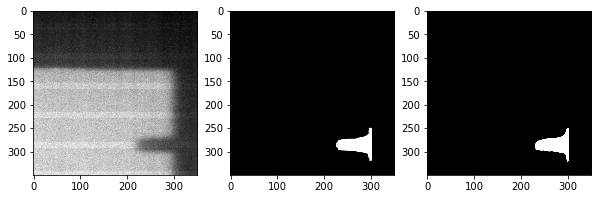

11: true_dist: 15, pred_dist: [15.459748]


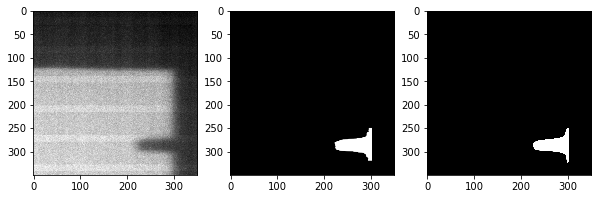

12: true_dist: 15, pred_dist: [15.28444]


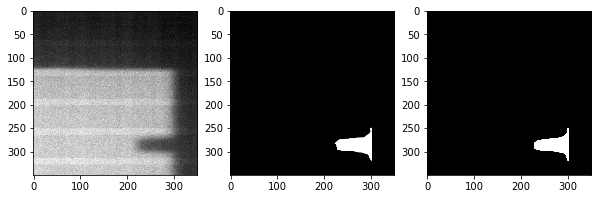

13: true_dist: 15, pred_dist: [15.156785]


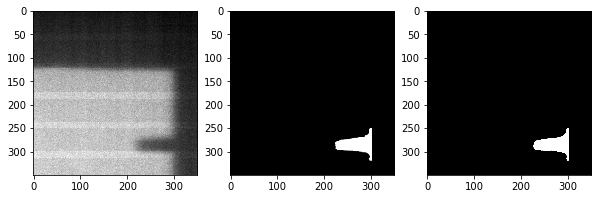

14: true_dist: 15, pred_dist: [15.373267]


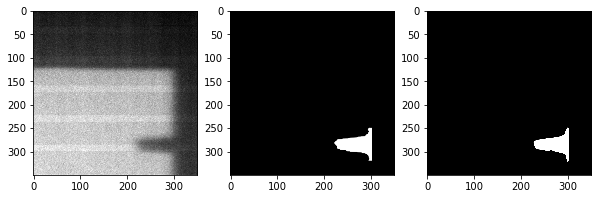

15: true_dist: 15, pred_dist: [15.589826]


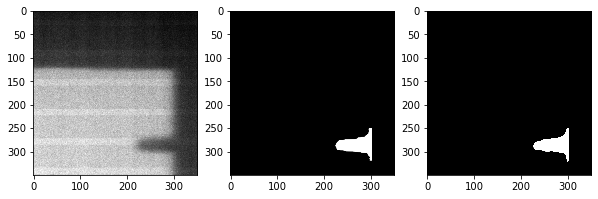

16: true_dist: 15, pred_dist: [15.542831]


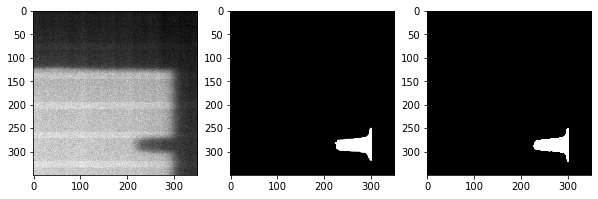

In [83]:
for epoch in np.arange(110, 150, 10):
    predict_coef_epoch(4, epoch)

Trained_rUNet_pytorch_6positions_dataset_110epochs_0.7coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [14.045133]


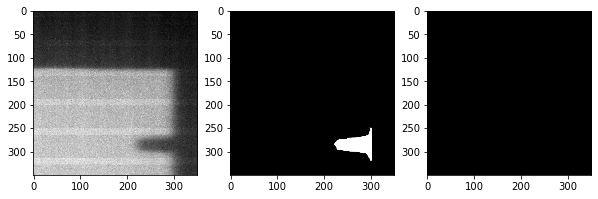

2: true_dist: 15, pred_dist: [15.759815]


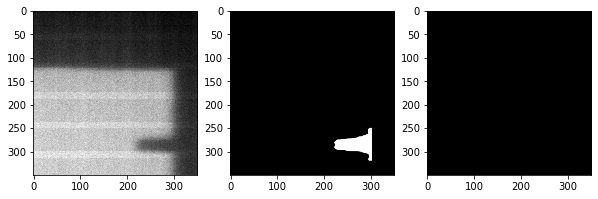

3: true_dist: 15, pred_dist: [18.047947]


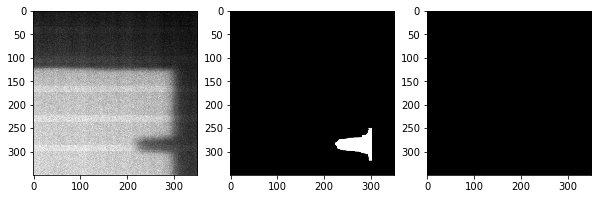

4: true_dist: 15, pred_dist: [14.944042]


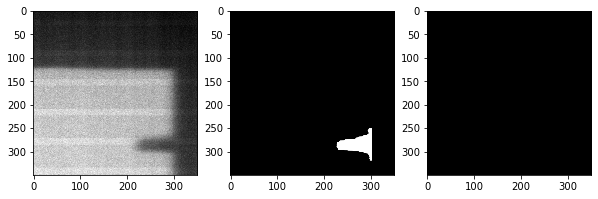

5: true_dist: 15, pred_dist: [14.350139]


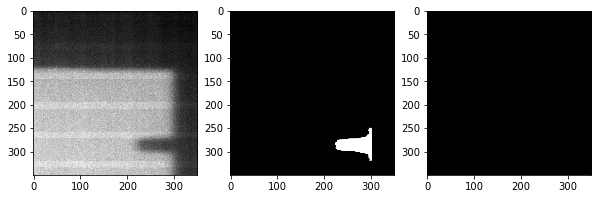

6: true_dist: 15, pred_dist: [13.485295]


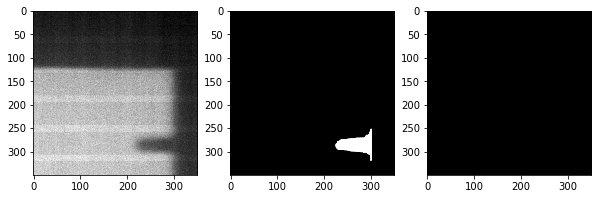

7: true_dist: 15, pred_dist: [16.869379]


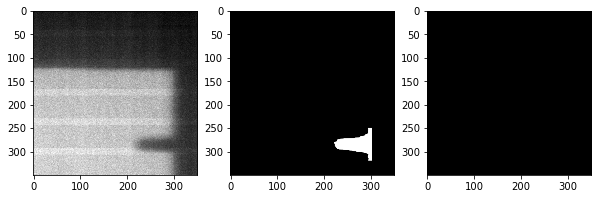

8: true_dist: 15, pred_dist: [15.810857]


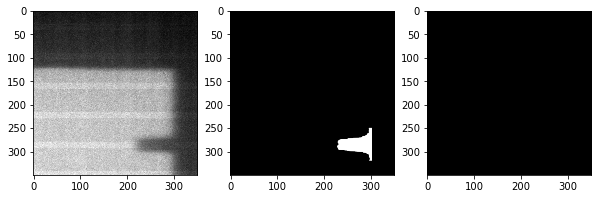

9: true_dist: 15, pred_dist: [14.063562]


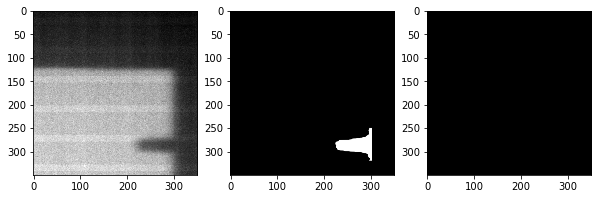

10: true_dist: 15, pred_dist: [13.590419]


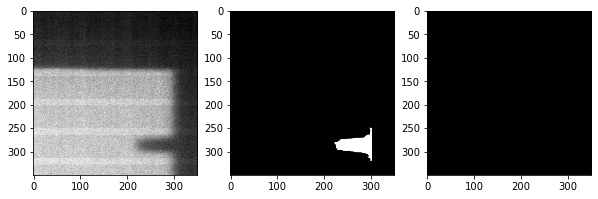

11: true_dist: 15, pred_dist: [14.615024]


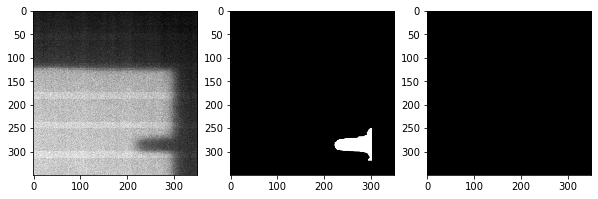

12: true_dist: 15, pred_dist: [17.215178]


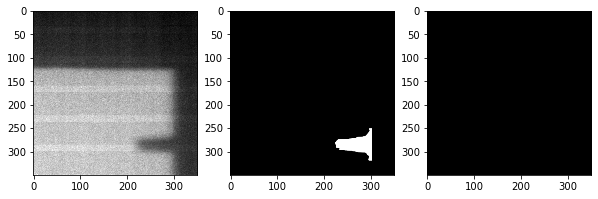

13: true_dist: 15, pred_dist: [14.28831]


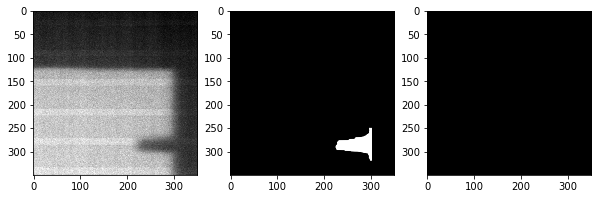

14: true_dist: 15, pred_dist: [14.007919]


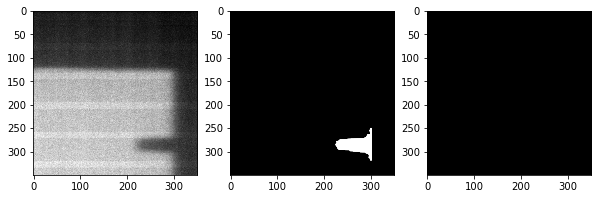

15: true_dist: 15, pred_dist: [12.779014]


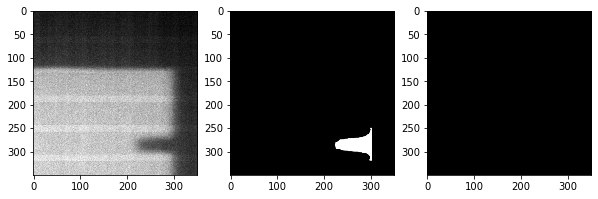

16: true_dist: 15, pred_dist: [16.814066]


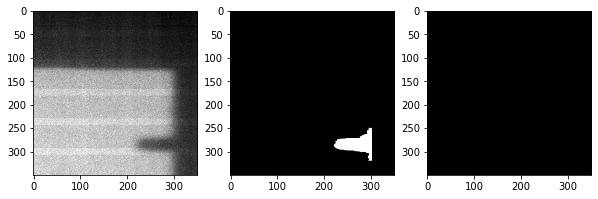

batch 2
1: true_dist: 15, pred_dist: [16.195932]


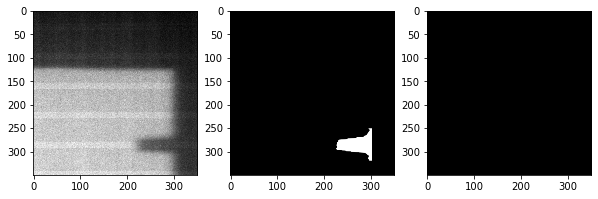

2: true_dist: 15, pred_dist: [14.132329]


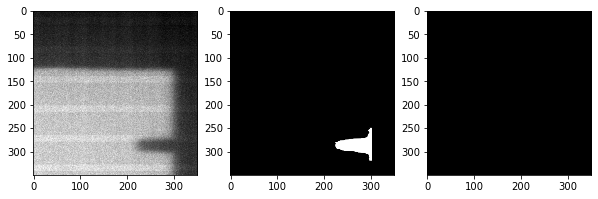

3: true_dist: 15, pred_dist: [13.452136]


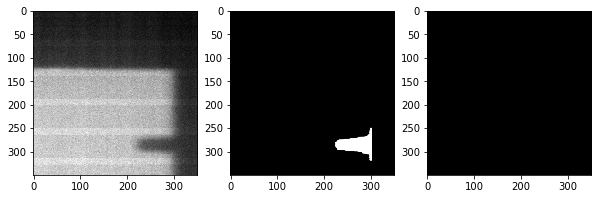

4: true_dist: 15, pred_dist: [14.391405]


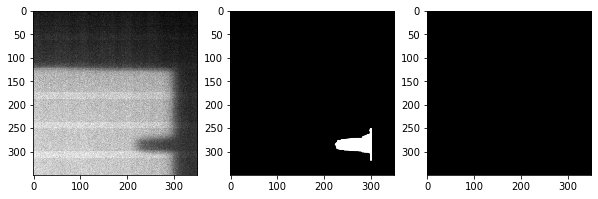

5: true_dist: 15, pred_dist: [17.740784]


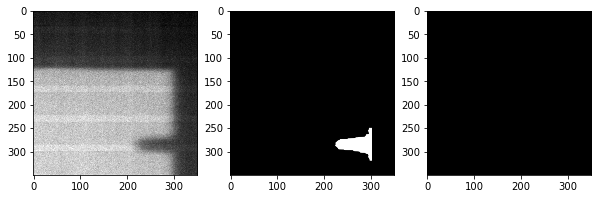

6: true_dist: 15, pred_dist: [14.73542]


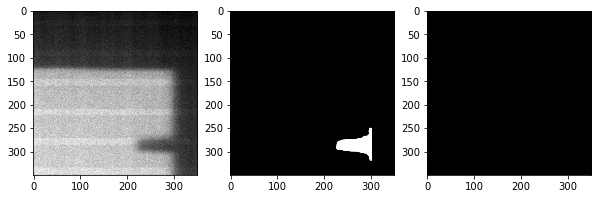

7: true_dist: 15, pred_dist: [13.841226]


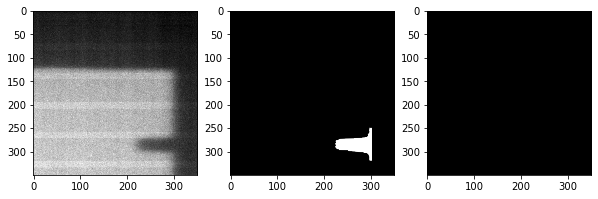

8: true_dist: 15, pred_dist: [13.546932]


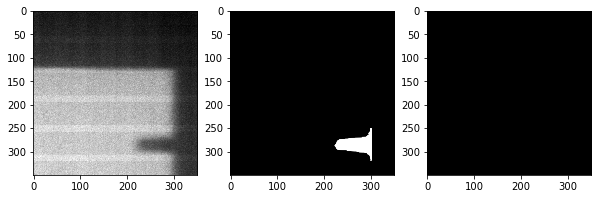

9: true_dist: 15, pred_dist: [17.081177]


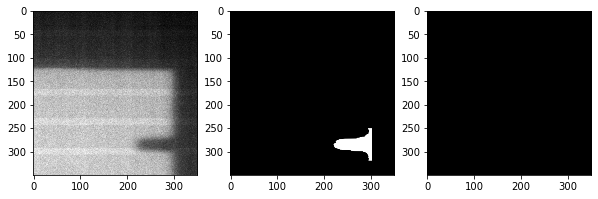

10: true_dist: 15, pred_dist: [16.71522]


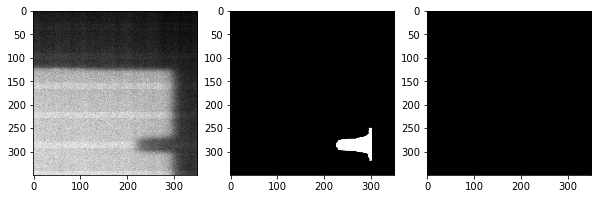

11: true_dist: 15, pred_dist: [14.592289]


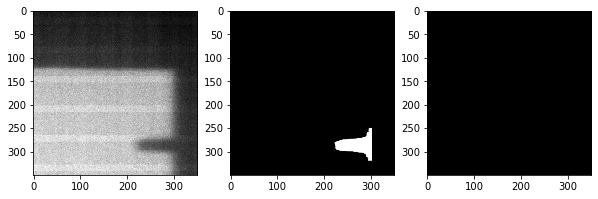

12: true_dist: 15, pred_dist: [13.877444]


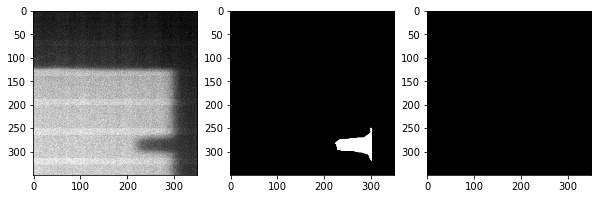

13: true_dist: 15, pred_dist: [15.370659]


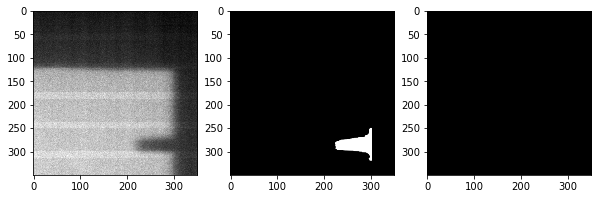

14: true_dist: 15, pred_dist: [17.113678]


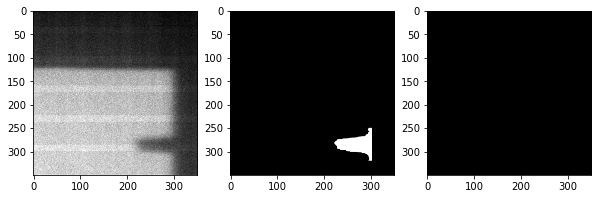

15: true_dist: 15, pred_dist: [15.136784]


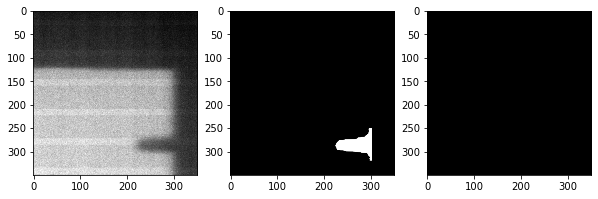

16: true_dist: 15, pred_dist: [14.744817]


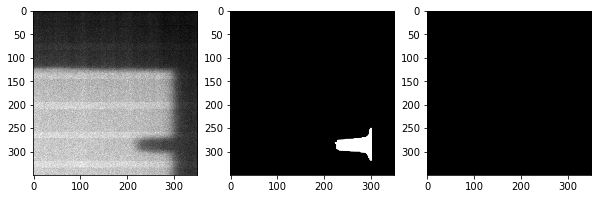

Trained_rUNet_pytorch_6positions_dataset_120epochs_0.7coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [14.456168]


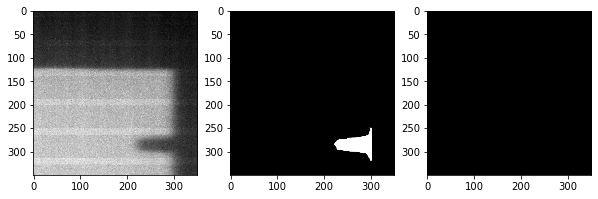

2: true_dist: 15, pred_dist: [15.152603]


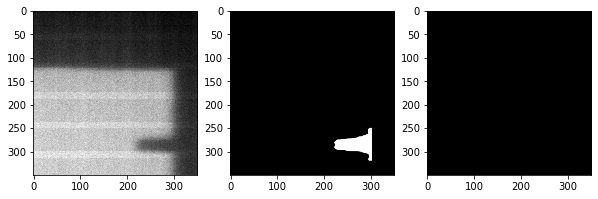

3: true_dist: 15, pred_dist: [16.203259]


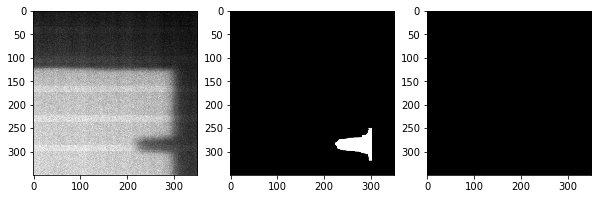

4: true_dist: 15, pred_dist: [14.809413]


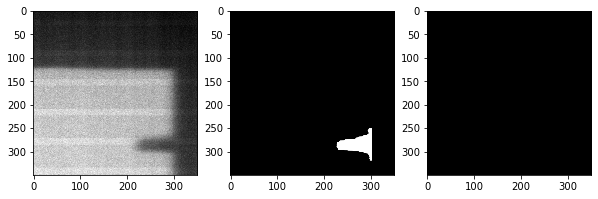

5: true_dist: 15, pred_dist: [14.427662]


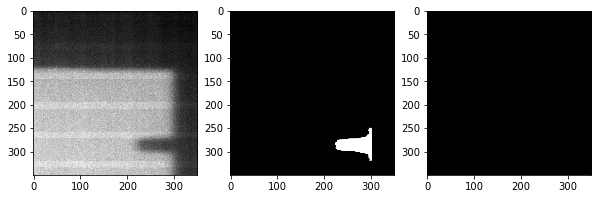

6: true_dist: 15, pred_dist: [14.051482]


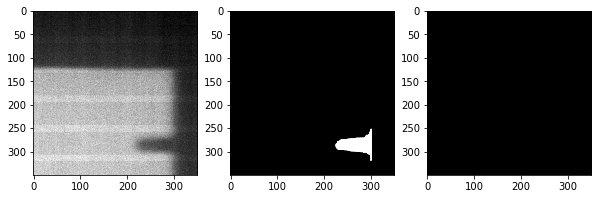

7: true_dist: 15, pred_dist: [15.408989]


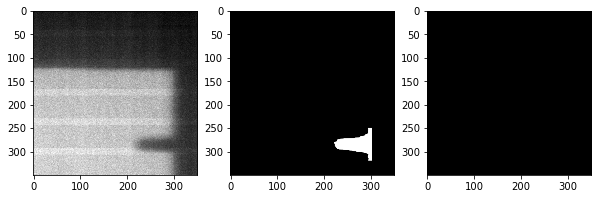

8: true_dist: 15, pred_dist: [15.376848]


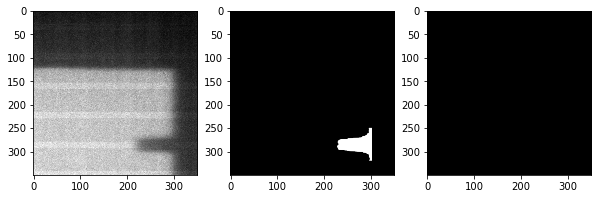

9: true_dist: 15, pred_dist: [14.206255]


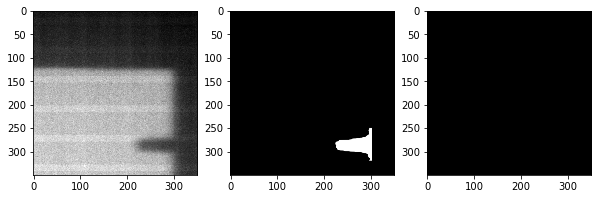

10: true_dist: 15, pred_dist: [14.008114]


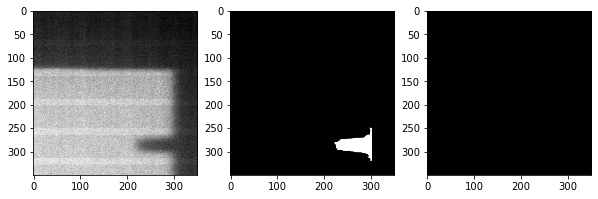

11: true_dist: 15, pred_dist: [14.247426]


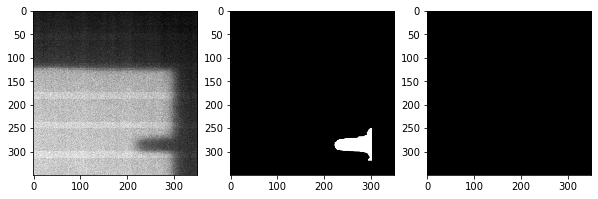

12: true_dist: 15, pred_dist: [15.699954]


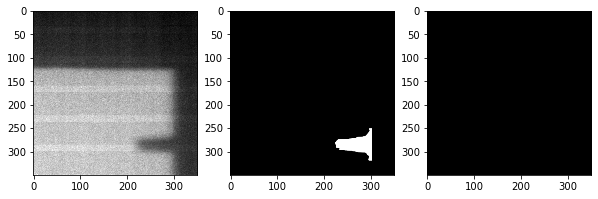

13: true_dist: 15, pred_dist: [14.537064]


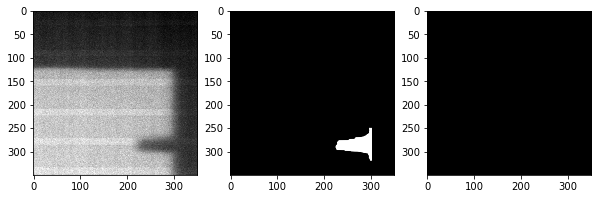

14: true_dist: 15, pred_dist: [14.260063]


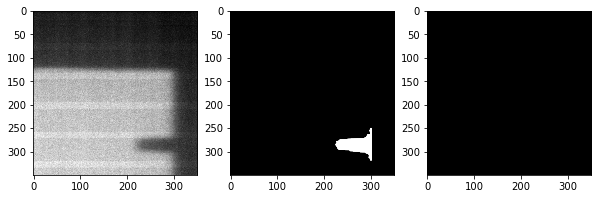

15: true_dist: 15, pred_dist: [13.460279]


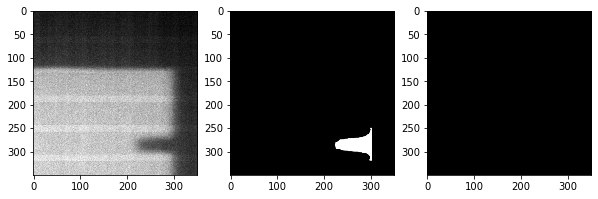

16: true_dist: 15, pred_dist: [15.309584]


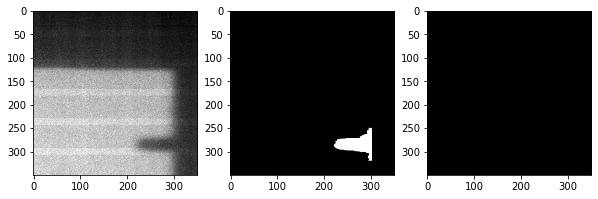

batch 2
1: true_dist: 15, pred_dist: [15.576034]


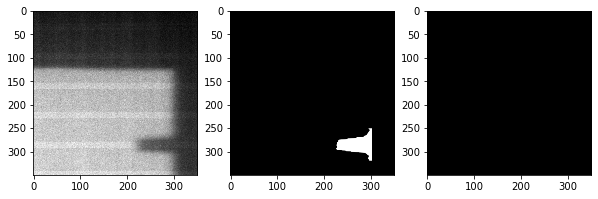

2: true_dist: 15, pred_dist: [14.283047]


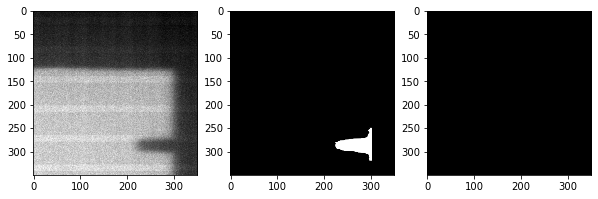

3: true_dist: 15, pred_dist: [13.99352]


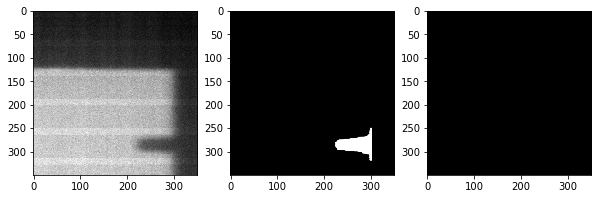

4: true_dist: 15, pred_dist: [14.0488]


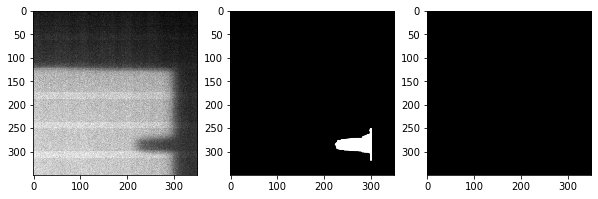

5: true_dist: 15, pred_dist: [16.107178]


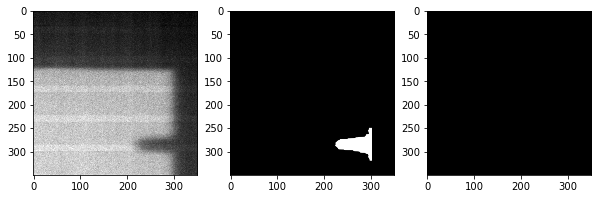

6: true_dist: 15, pred_dist: [14.691962]


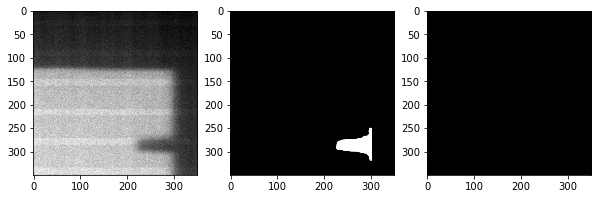

7: true_dist: 15, pred_dist: [14.131134]


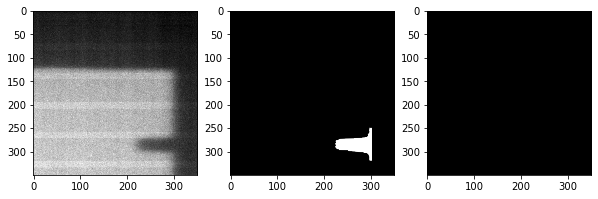

8: true_dist: 15, pred_dist: [14.029981]


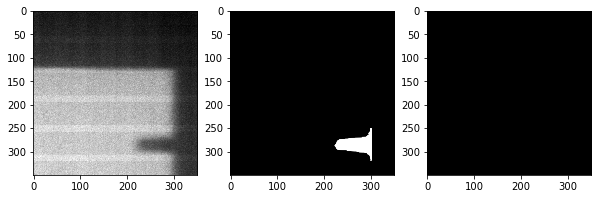

9: true_dist: 15, pred_dist: [15.529443]


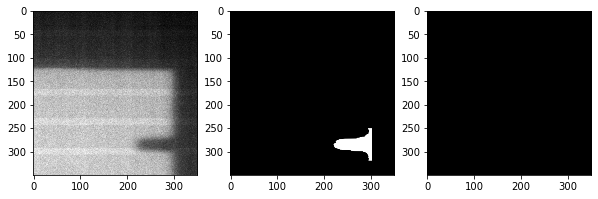

10: true_dist: 15, pred_dist: [15.77091]


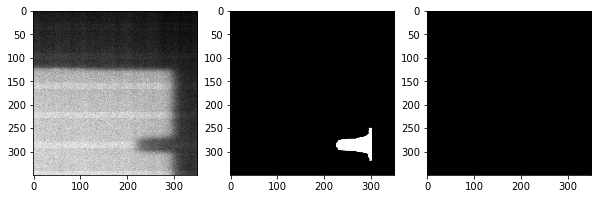

11: true_dist: 15, pred_dist: [14.66625]


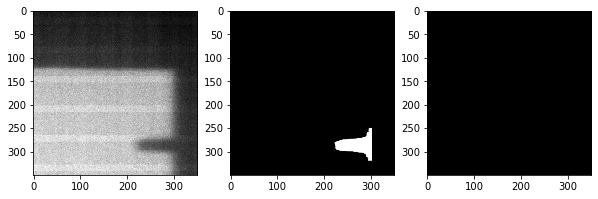

12: true_dist: 15, pred_dist: [14.291568]


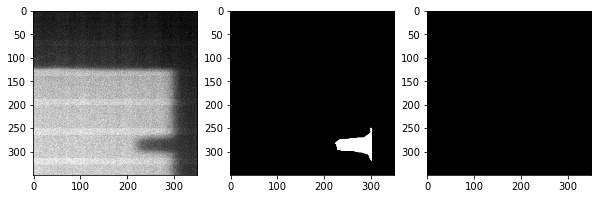

13: true_dist: 15, pred_dist: [14.819876]


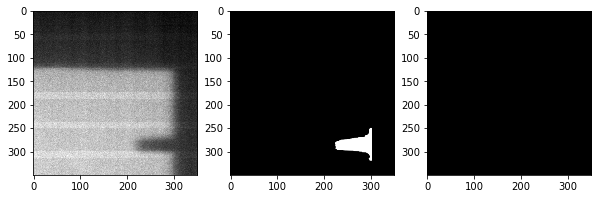

14: true_dist: 15, pred_dist: [15.63378]


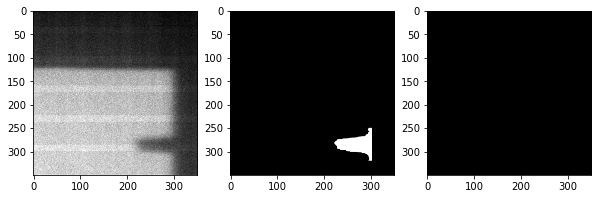

15: true_dist: 15, pred_dist: [14.97903]


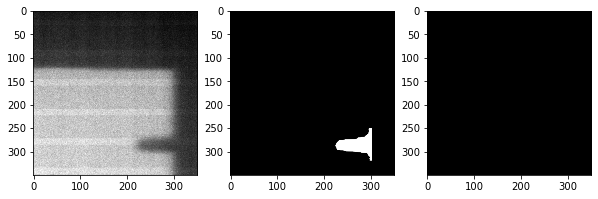

16: true_dist: 15, pred_dist: [14.76635]


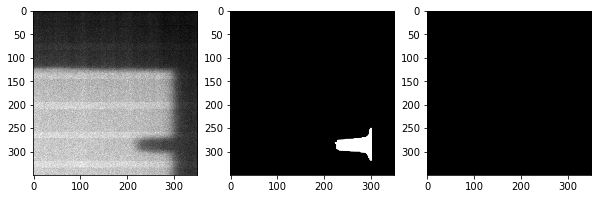

Trained_rUNet_pytorch_6positions_dataset_130epochs_0.7coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [15.185404]


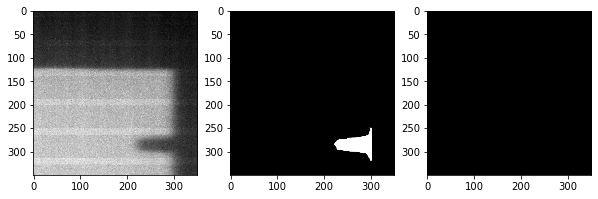

2: true_dist: 15, pred_dist: [15.794684]


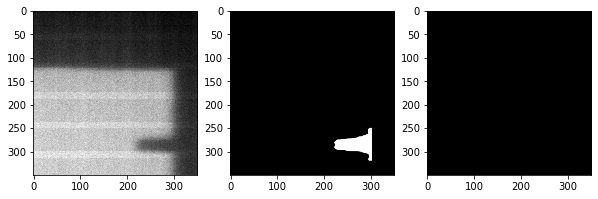

3: true_dist: 15, pred_dist: [16.205889]


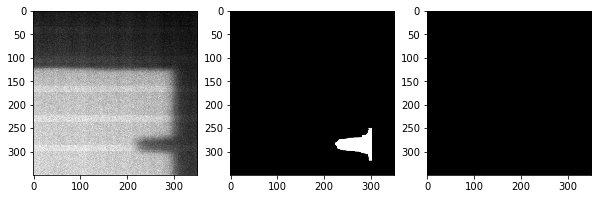

4: true_dist: 15, pred_dist: [15.4456]


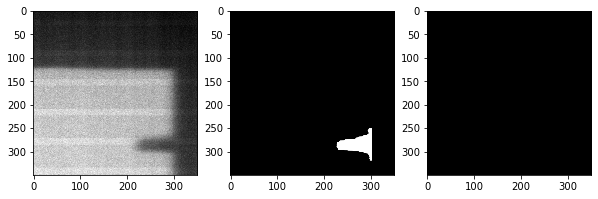

5: true_dist: 15, pred_dist: [15.057434]


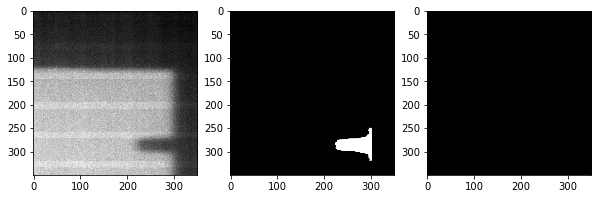

6: true_dist: 15, pred_dist: [14.908222]


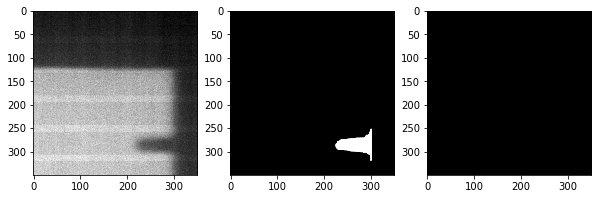

7: true_dist: 15, pred_dist: [15.797009]


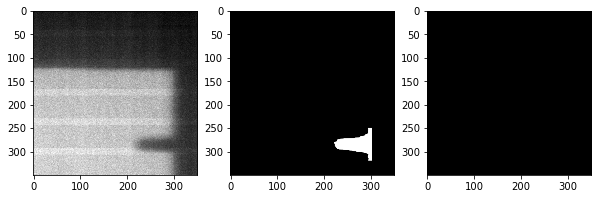

8: true_dist: 15, pred_dist: [15.762089]


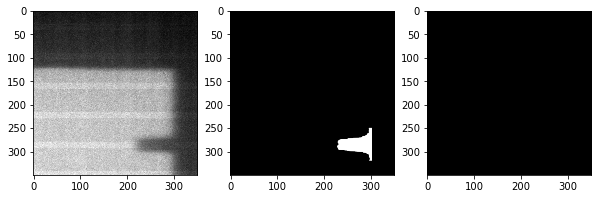

9: true_dist: 15, pred_dist: [14.923349]


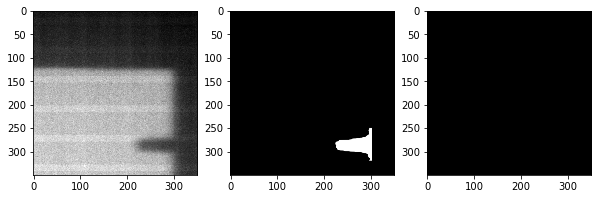

10: true_dist: 15, pred_dist: [14.778008]


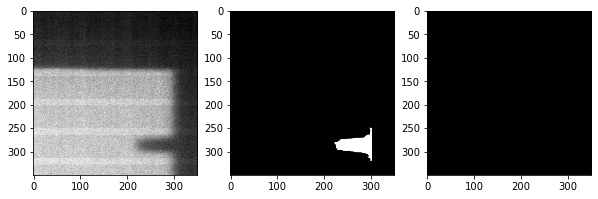

11: true_dist: 15, pred_dist: [15.049401]


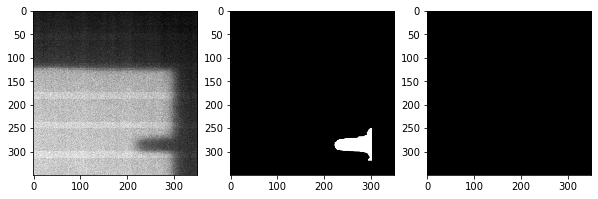

12: true_dist: 15, pred_dist: [15.870991]


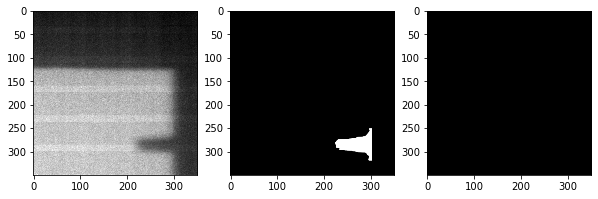

13: true_dist: 15, pred_dist: [15.251485]


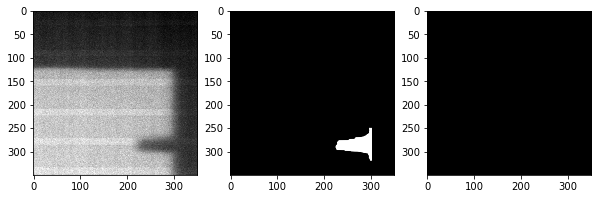

14: true_dist: 15, pred_dist: [14.874971]


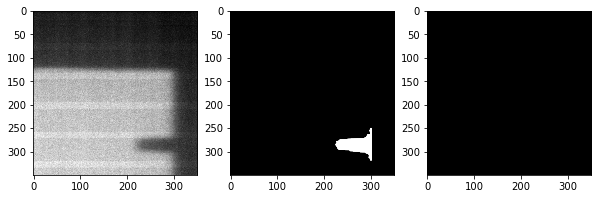

15: true_dist: 15, pred_dist: [14.423323]


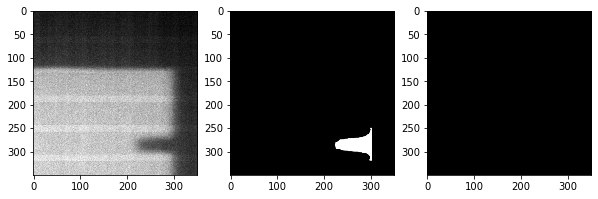

16: true_dist: 15, pred_dist: [15.728335]


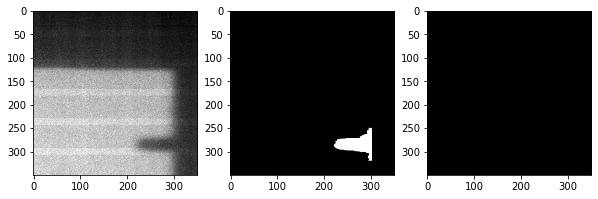

batch 2
1: true_dist: 15, pred_dist: [15.98962]


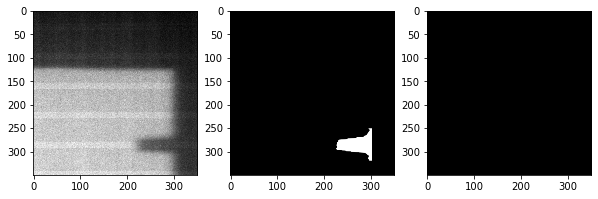

2: true_dist: 15, pred_dist: [14.963667]


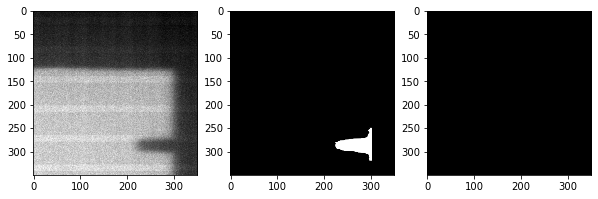

3: true_dist: 15, pred_dist: [14.776615]


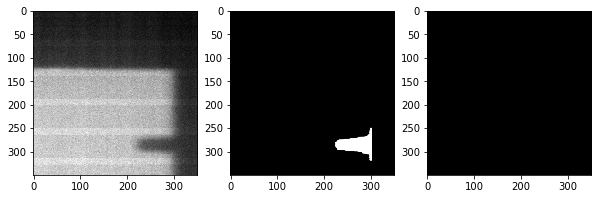

4: true_dist: 15, pred_dist: [14.871441]


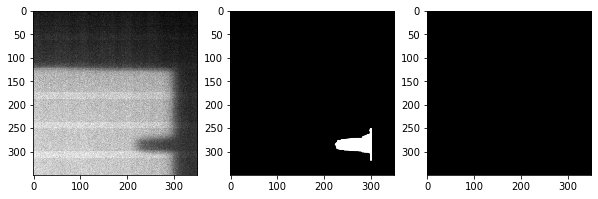

5: true_dist: 15, pred_dist: [16.199644]


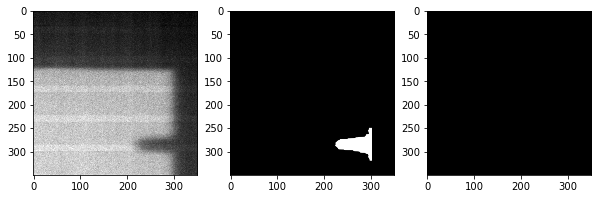

6: true_dist: 15, pred_dist: [15.370063]


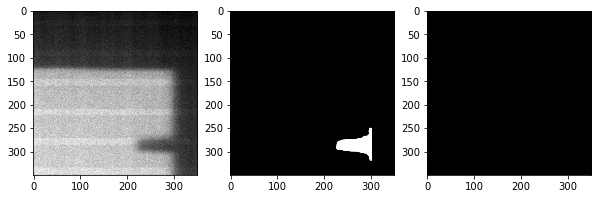

7: true_dist: 15, pred_dist: [14.913313]


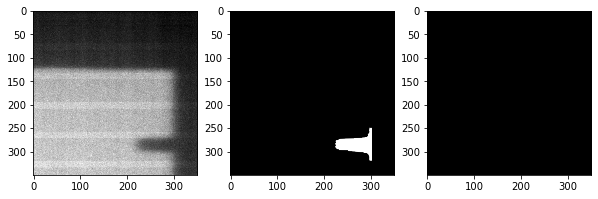

8: true_dist: 15, pred_dist: [14.919295]


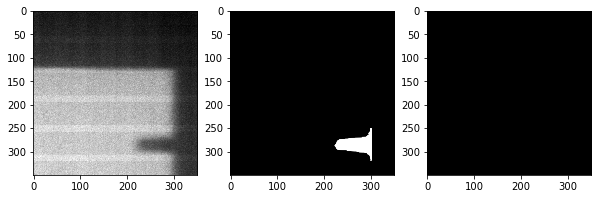

9: true_dist: 15, pred_dist: [15.908619]


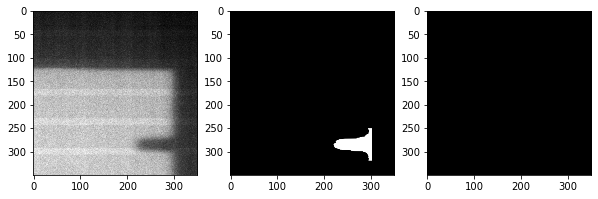

10: true_dist: 15, pred_dist: [16.112967]


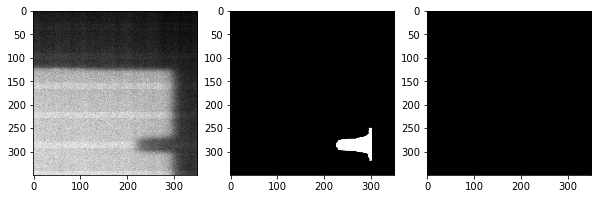

11: true_dist: 15, pred_dist: [15.310562]


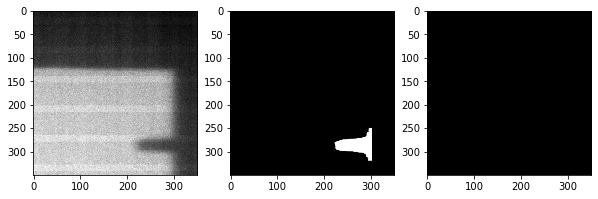

12: true_dist: 15, pred_dist: [15.0543585]


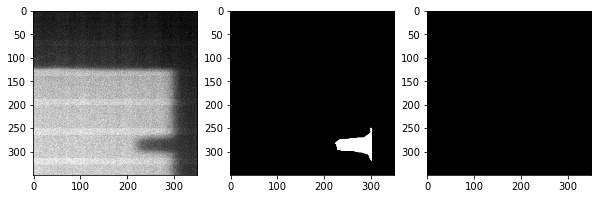

13: true_dist: 15, pred_dist: [15.516861]


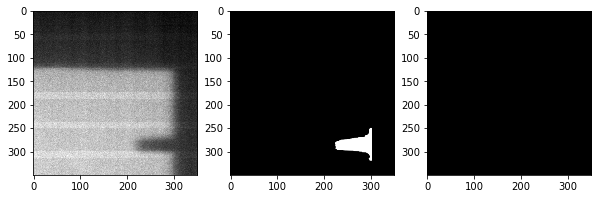

14: true_dist: 15, pred_dist: [15.853796]


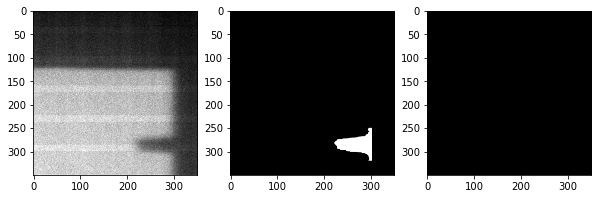

15: true_dist: 15, pred_dist: [15.59594]


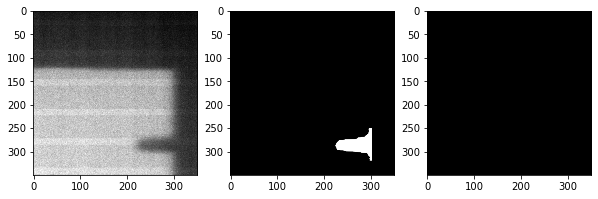

16: true_dist: 15, pred_dist: [15.268707]


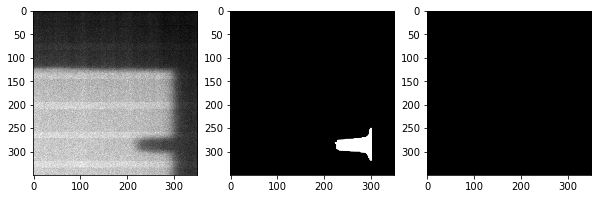

Trained_rUNet_pytorch_6positions_dataset_140epochs_0.7coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [15.068039]


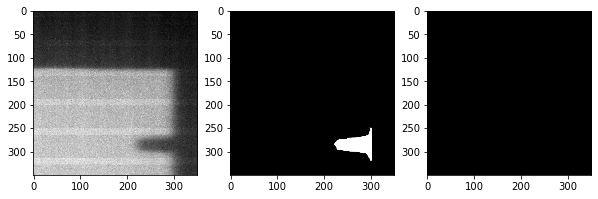

2: true_dist: 15, pred_dist: [15.472269]


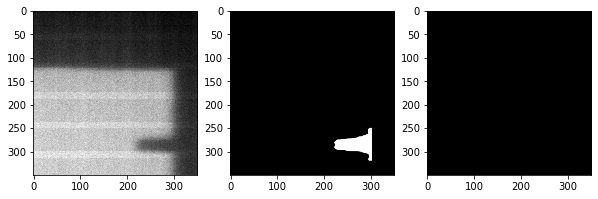

3: true_dist: 15, pred_dist: [15.688913]


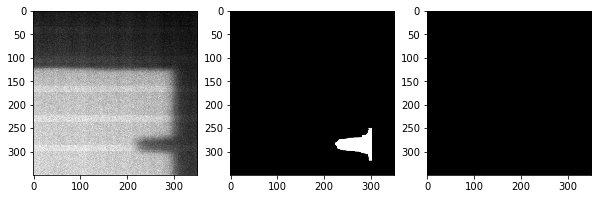

4: true_dist: 15, pred_dist: [15.216133]


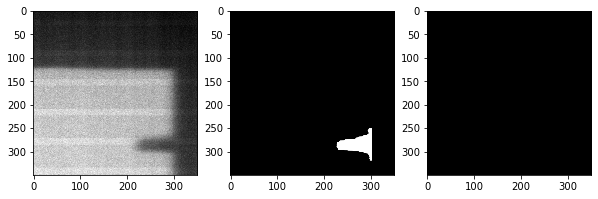

5: true_dist: 15, pred_dist: [14.9372]


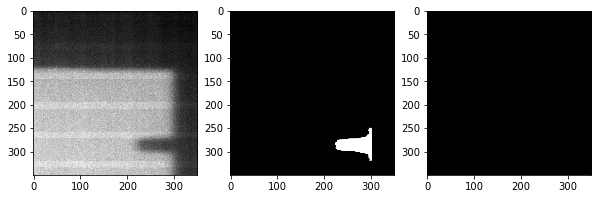

6: true_dist: 15, pred_dist: [14.84467]


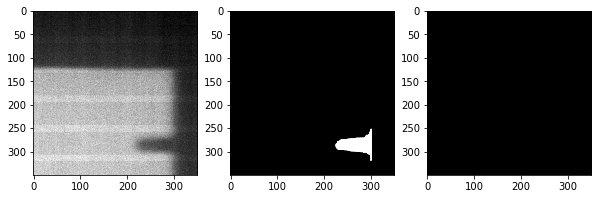

7: true_dist: 15, pred_dist: [15.337187]


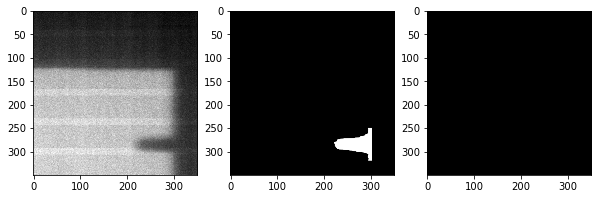

8: true_dist: 15, pred_dist: [15.485886]


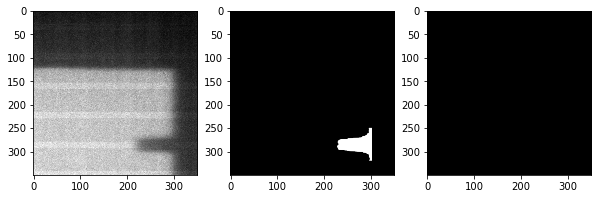

9: true_dist: 15, pred_dist: [14.811529]


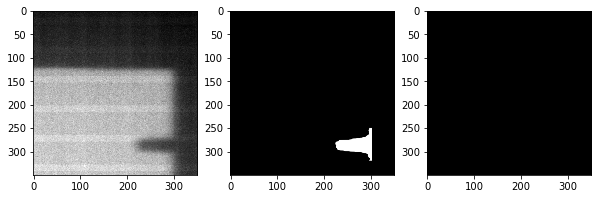

10: true_dist: 15, pred_dist: [14.734968]


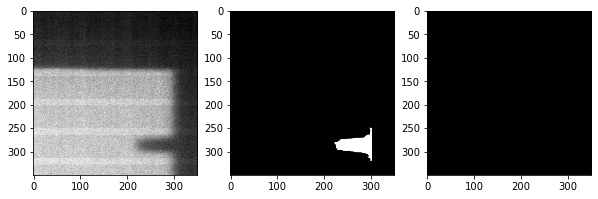

11: true_dist: 15, pred_dist: [14.909149]


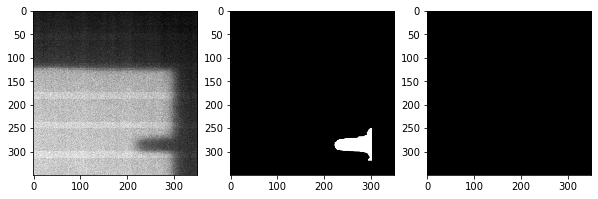

12: true_dist: 15, pred_dist: [15.400748]


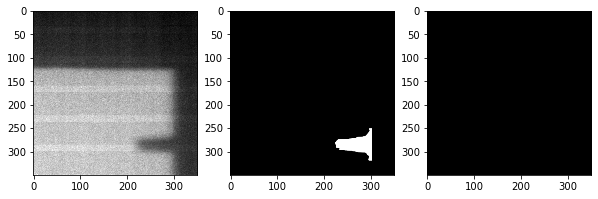

13: true_dist: 15, pred_dist: [15.064647]


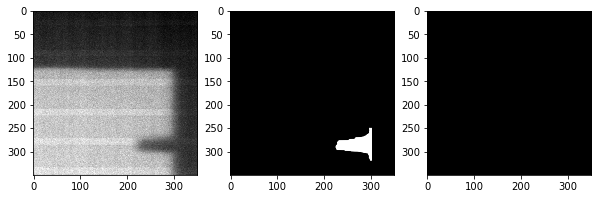

14: true_dist: 15, pred_dist: [14.745303]


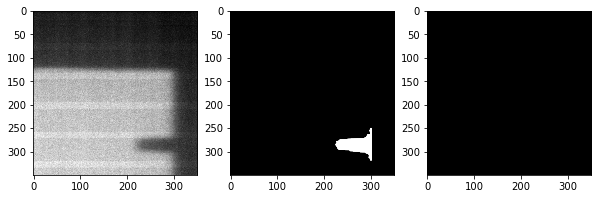

15: true_dist: 15, pred_dist: [14.424083]


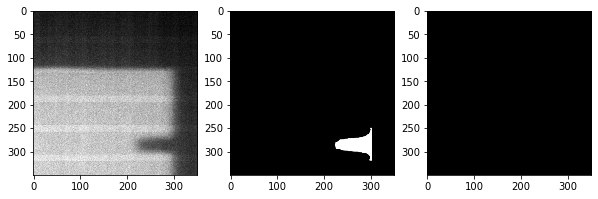

16: true_dist: 15, pred_dist: [15.314381]


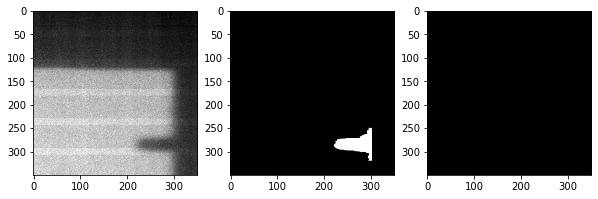

batch 2
1: true_dist: 15, pred_dist: [15.615684]


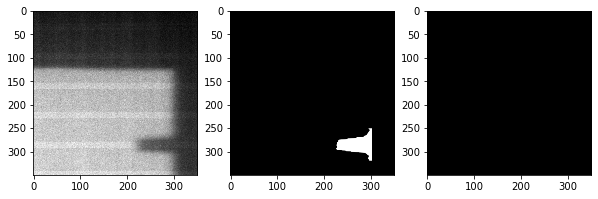

2: true_dist: 15, pred_dist: [14.820564]


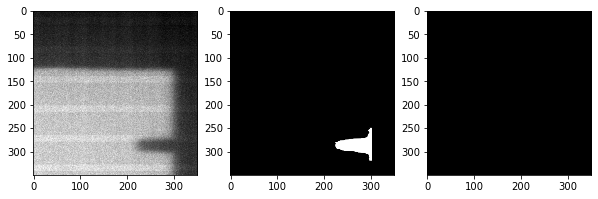

3: true_dist: 15, pred_dist: [14.723198]


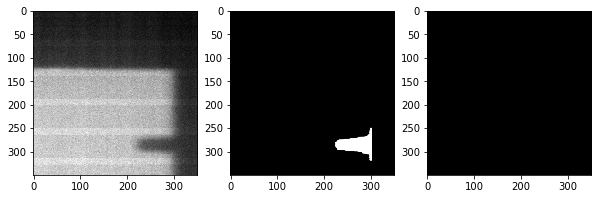

4: true_dist: 15, pred_dist: [14.741432]


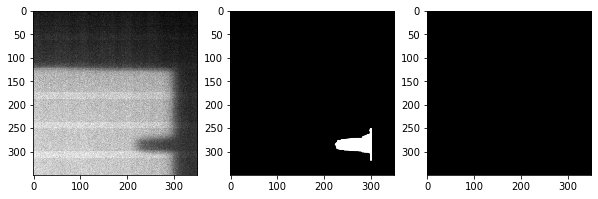

5: true_dist: 15, pred_dist: [15.686333]


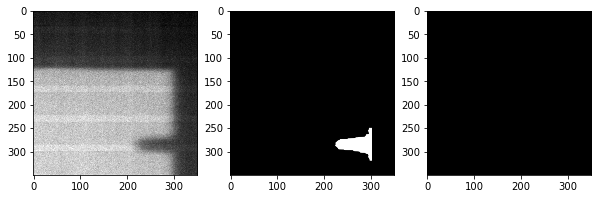

6: true_dist: 15, pred_dist: [15.161242]


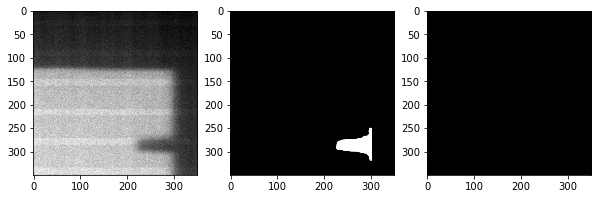

7: true_dist: 15, pred_dist: [14.7786455]


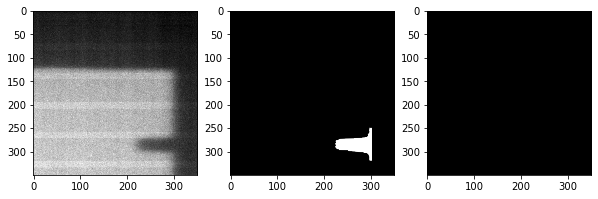

8: true_dist: 15, pred_dist: [14.838722]


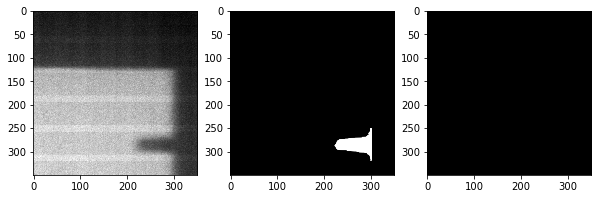

9: true_dist: 15, pred_dist: [15.444665]


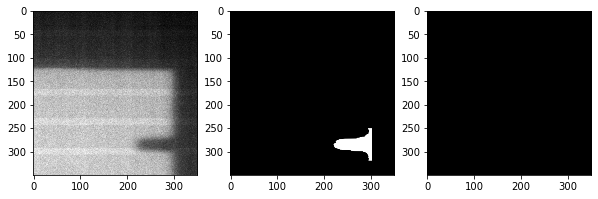

10: true_dist: 15, pred_dist: [15.721352]


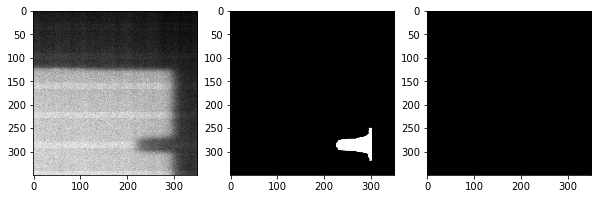

11: true_dist: 15, pred_dist: [15.120126]


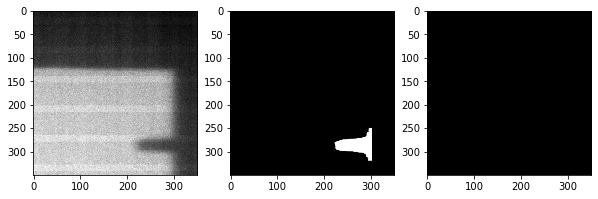

12: true_dist: 15, pred_dist: [14.973932]


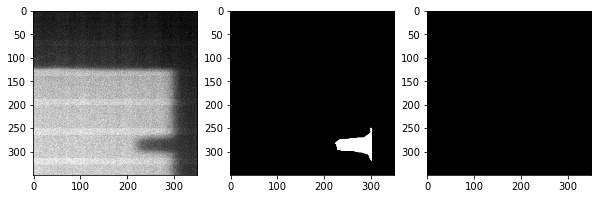

13: true_dist: 15, pred_dist: [15.232717]


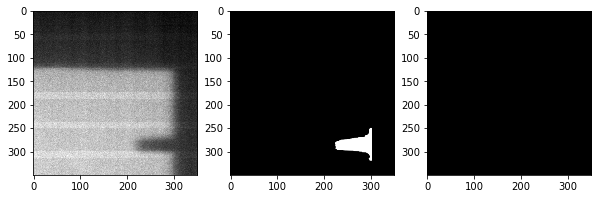

14: true_dist: 15, pred_dist: [15.408056]


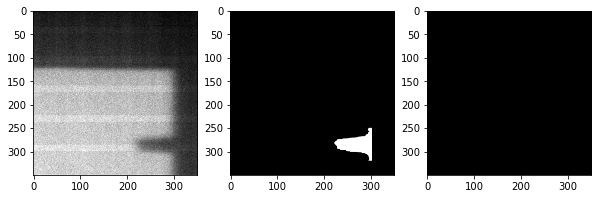

15: true_dist: 15, pred_dist: [15.3896265]


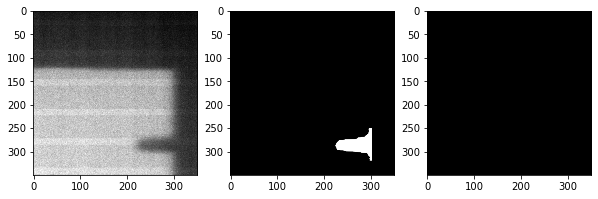

16: true_dist: 15, pred_dist: [15.0914135]


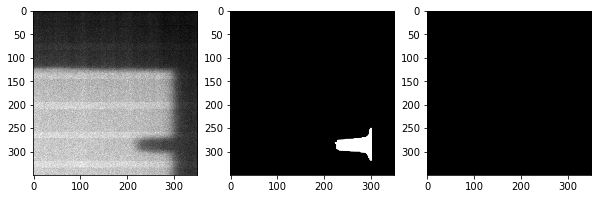

In [84]:
for epoch in np.arange(110, 150, 10):
    predict_coef_epoch(7, epoch)

### Testing new trained model (gaus30)

Trained_rUNet_pytorch_6positions_dataset_110epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [14.990298]


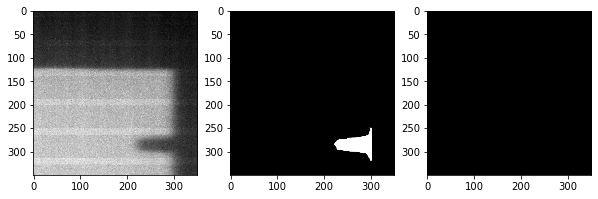

2: true_dist: 15, pred_dist: [15.052942]


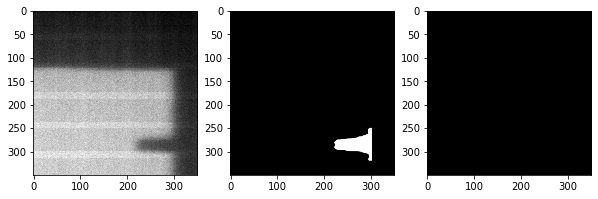

3: true_dist: 15, pred_dist: [14.429023]


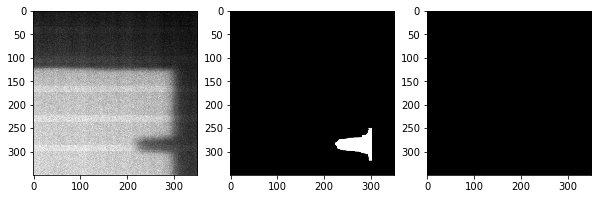

4: true_dist: 15, pred_dist: [14.844551]


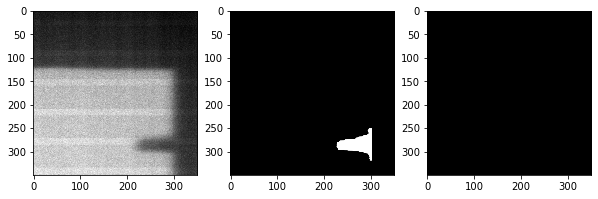

5: true_dist: 15, pred_dist: [14.945668]


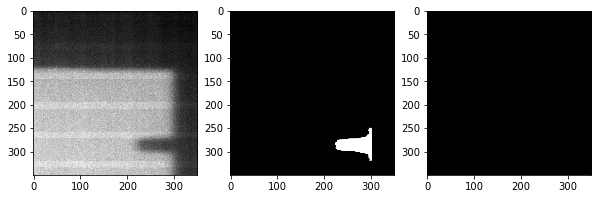

6: true_dist: 15, pred_dist: [14.924896]


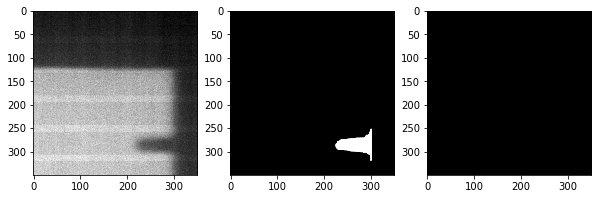

7: true_dist: 15, pred_dist: [14.659614]


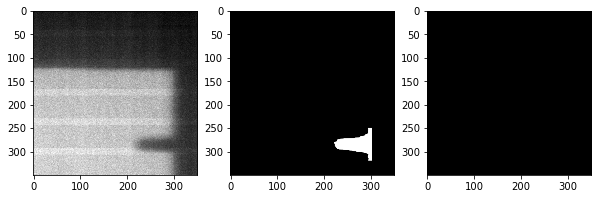

8: true_dist: 15, pred_dist: [14.337084]


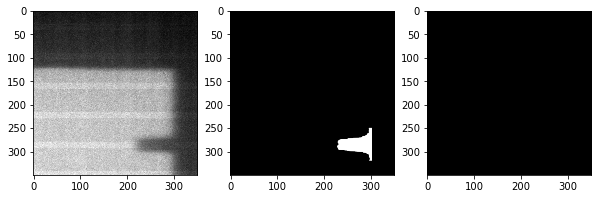

9: true_dist: 15, pred_dist: [14.905929]


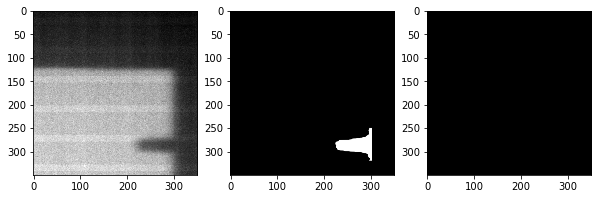

10: true_dist: 15, pred_dist: [14.94103]


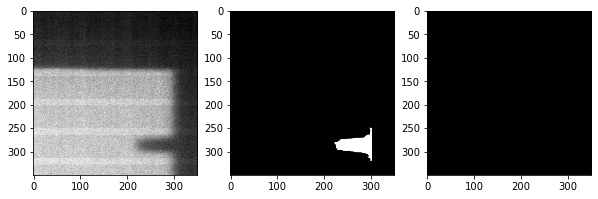

11: true_dist: 15, pred_dist: [14.914489]


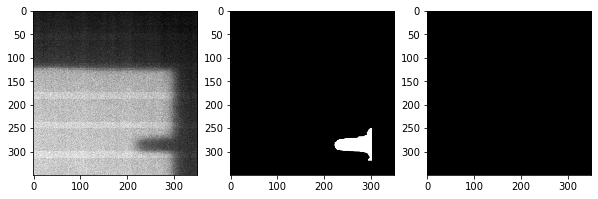

12: true_dist: 15, pred_dist: [14.352529]


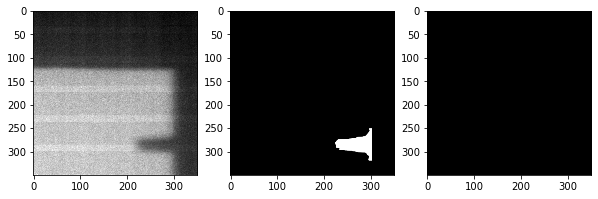

13: true_dist: 15, pred_dist: [14.892422]


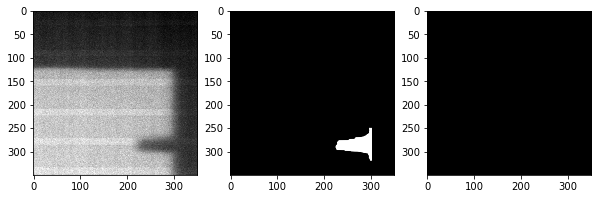

14: true_dist: 15, pred_dist: [15.061789]


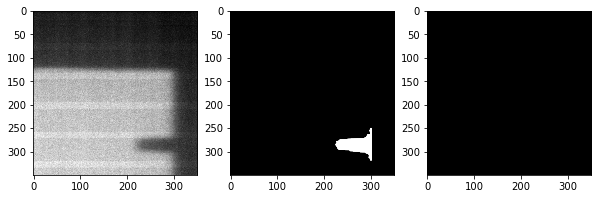

15: true_dist: 15, pred_dist: [14.821614]


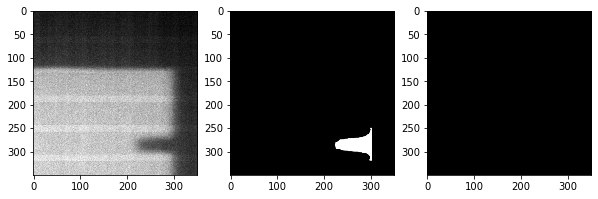

16: true_dist: 15, pred_dist: [14.678463]


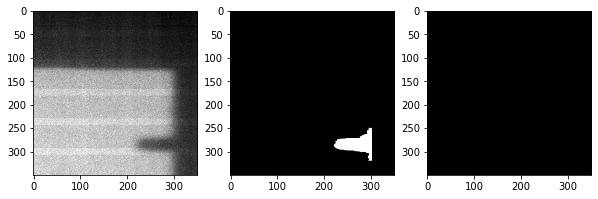

batch 2
1: true_dist: 15, pred_dist: [14.442251]


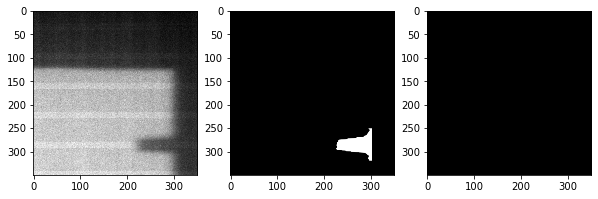

2: true_dist: 15, pred_dist: [15.129432]


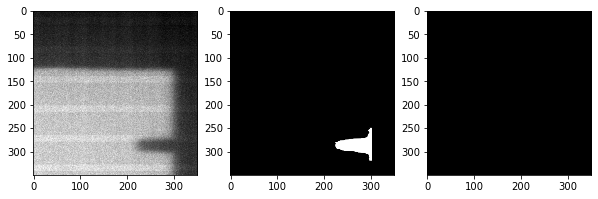

3: true_dist: 15, pred_dist: [14.914097]


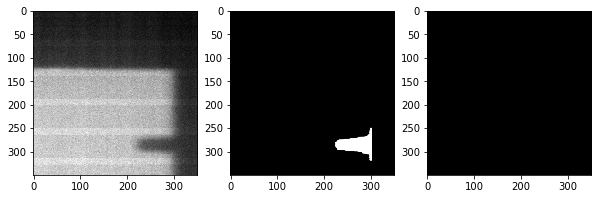

4: true_dist: 15, pred_dist: [14.925996]


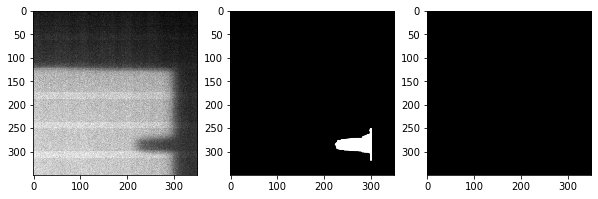

5: true_dist: 15, pred_dist: [14.424918]


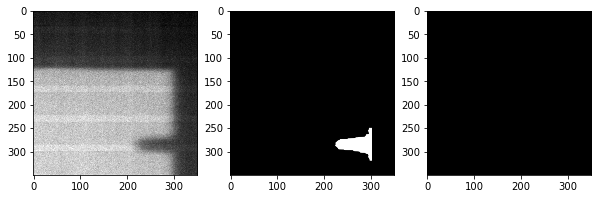

6: true_dist: 15, pred_dist: [15.01093]


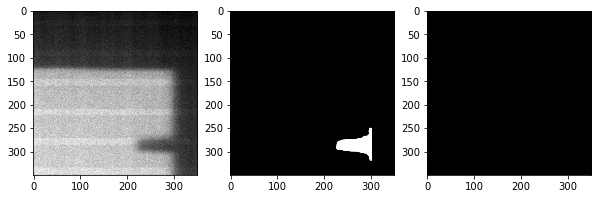

7: true_dist: 15, pred_dist: [15.038479]


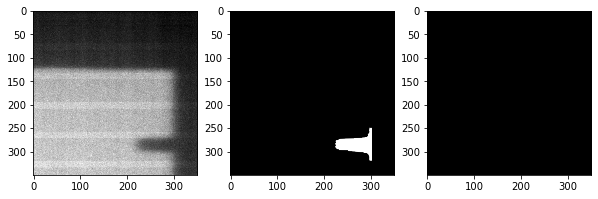

8: true_dist: 15, pred_dist: [15.041738]


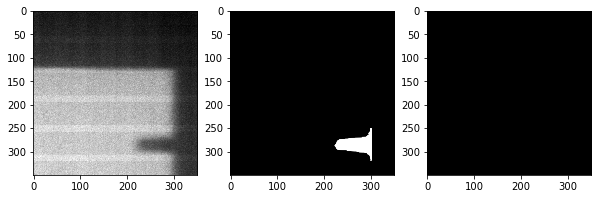

9: true_dist: 15, pred_dist: [14.701215]


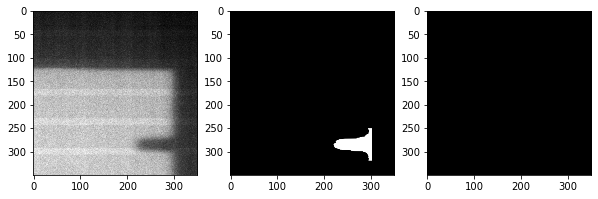

10: true_dist: 15, pred_dist: [14.589696]


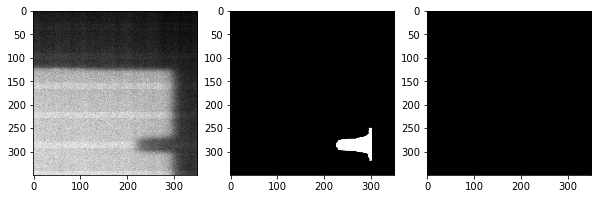

11: true_dist: 15, pred_dist: [15.115983]


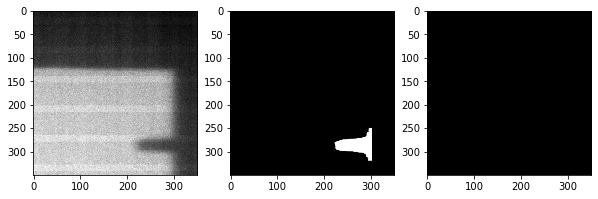

12: true_dist: 15, pred_dist: [14.938822]


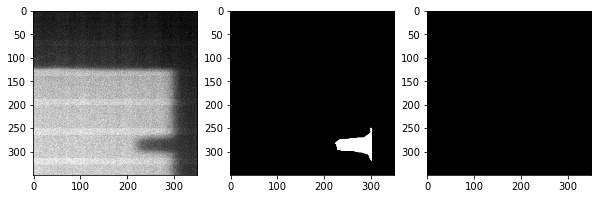

13: true_dist: 15, pred_dist: [15.031468]


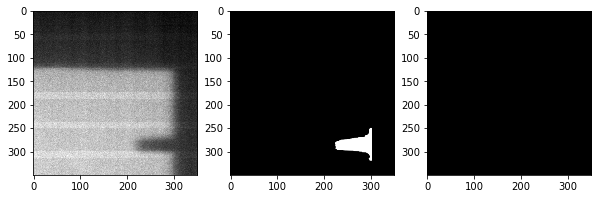

14: true_dist: 15, pred_dist: [14.364925]


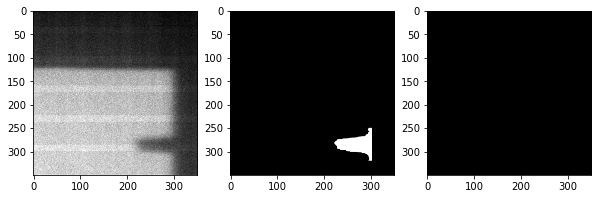

15: true_dist: 15, pred_dist: [14.941123]


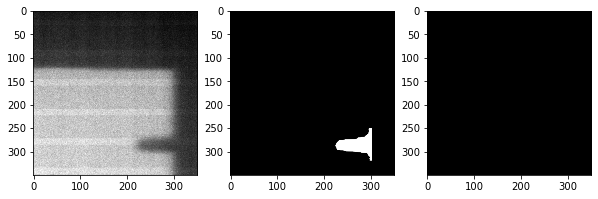

16: true_dist: 15, pred_dist: [14.9363165]


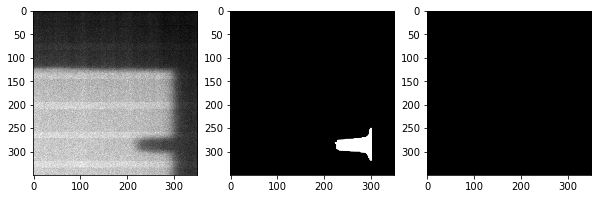

Trained_rUNet_pytorch_6positions_dataset_120epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [15.09213]


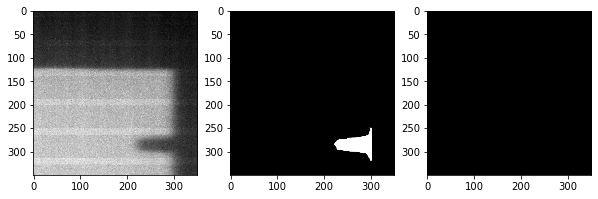

2: true_dist: 15, pred_dist: [15.317295]


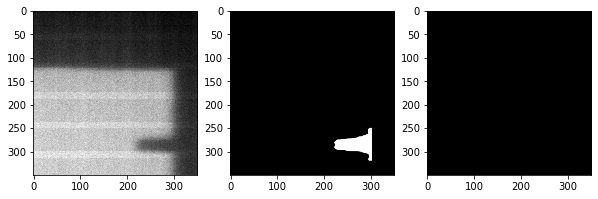

3: true_dist: 15, pred_dist: [14.913556]


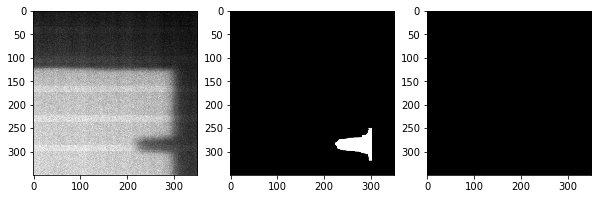

4: true_dist: 15, pred_dist: [15.167254]


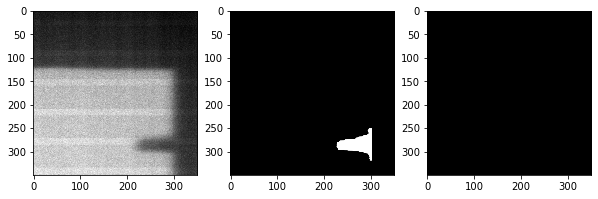

5: true_dist: 15, pred_dist: [15.049915]


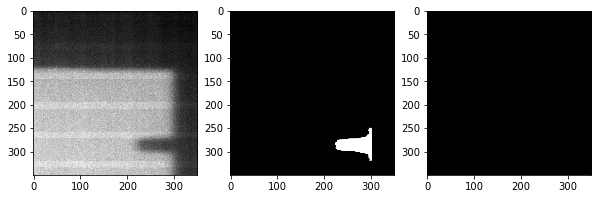

6: true_dist: 15, pred_dist: [15.17406]


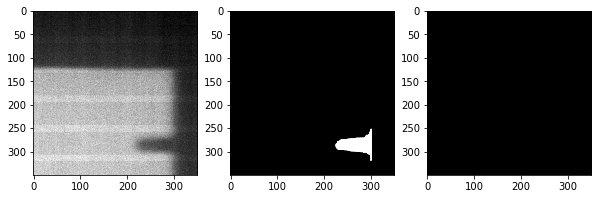

7: true_dist: 15, pred_dist: [15.067747]


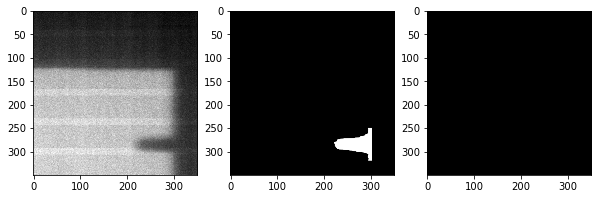

8: true_dist: 15, pred_dist: [14.91986]


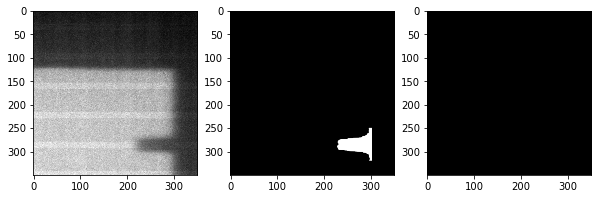

9: true_dist: 15, pred_dist: [15.144144]


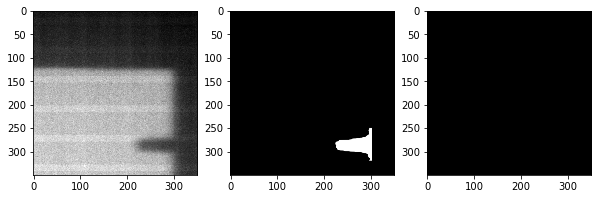

10: true_dist: 15, pred_dist: [15.179672]


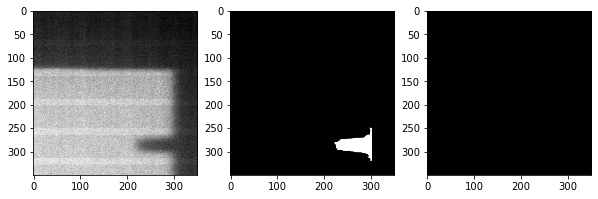

11: true_dist: 15, pred_dist: [15.301653]


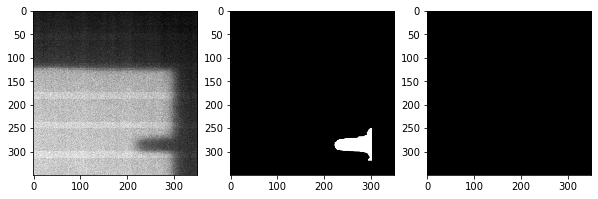

12: true_dist: 15, pred_dist: [14.913567]


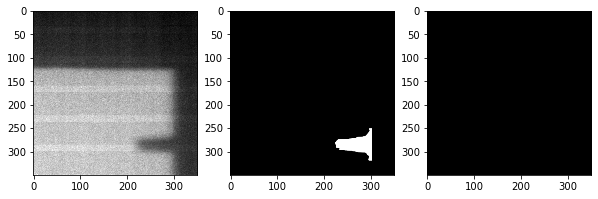

13: true_dist: 15, pred_dist: [15.316509]


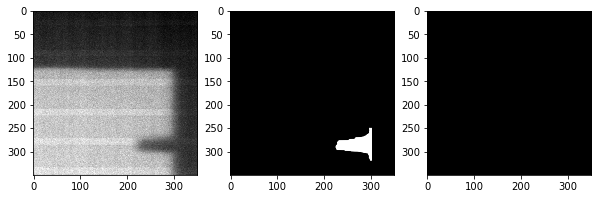

14: true_dist: 15, pred_dist: [15.206774]


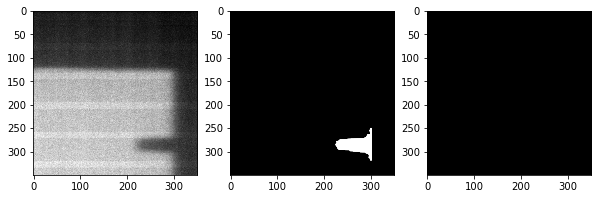

15: true_dist: 15, pred_dist: [15.16046]


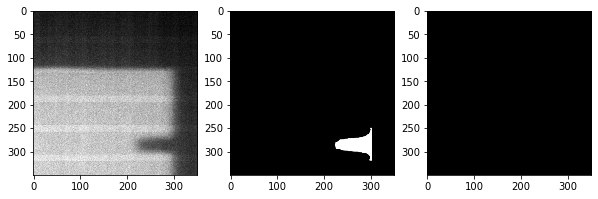

16: true_dist: 15, pred_dist: [15.0849695]


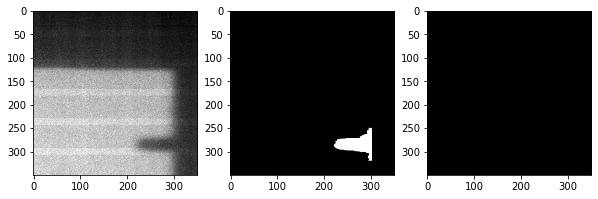

batch 2
1: true_dist: 15, pred_dist: [15.005877]


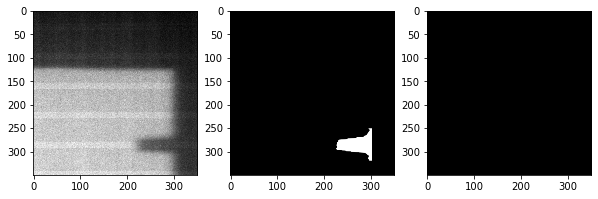

2: true_dist: 15, pred_dist: [15.291676]


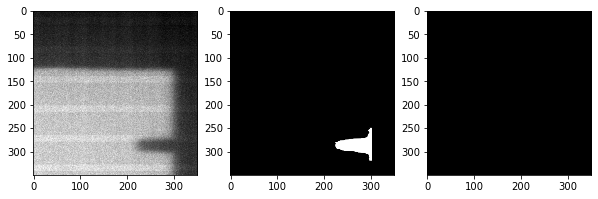

3: true_dist: 15, pred_dist: [15.09822]


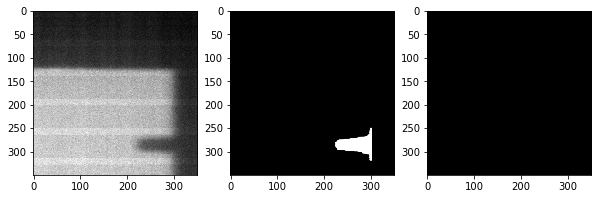

4: true_dist: 15, pred_dist: [15.263006]


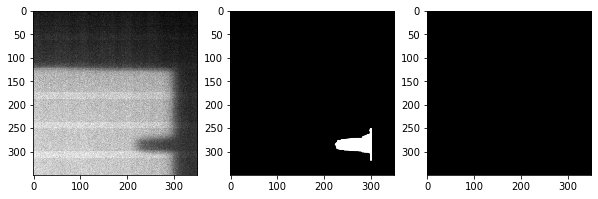

5: true_dist: 15, pred_dist: [14.895092]


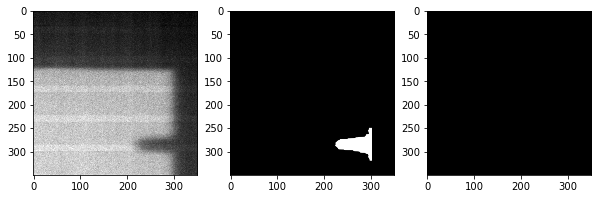

6: true_dist: 15, pred_dist: [15.333116]


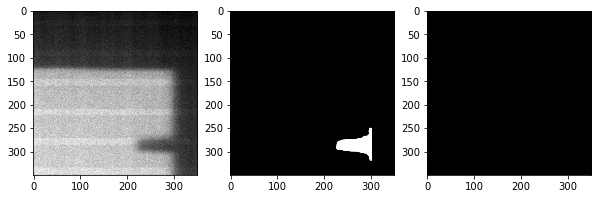

7: true_dist: 15, pred_dist: [15.138171]


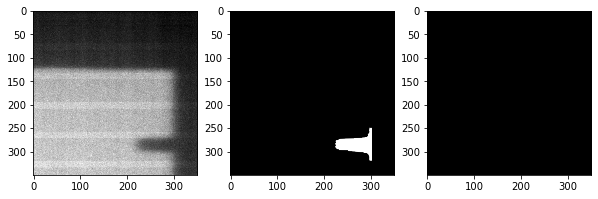

8: true_dist: 15, pred_dist: [15.17369]


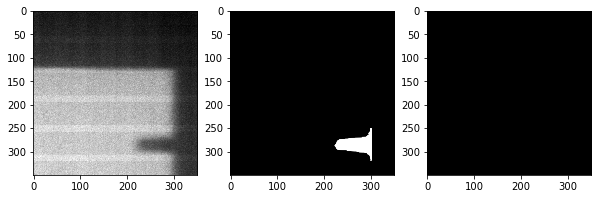

9: true_dist: 15, pred_dist: [14.936788]


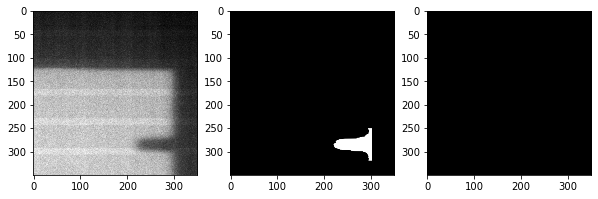

10: true_dist: 15, pred_dist: [14.990172]


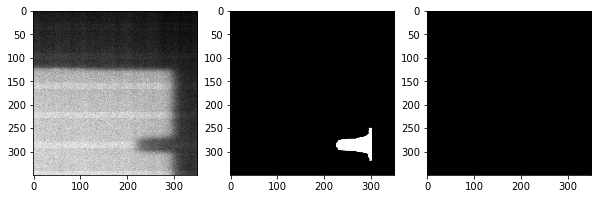

11: true_dist: 15, pred_dist: [15.201419]


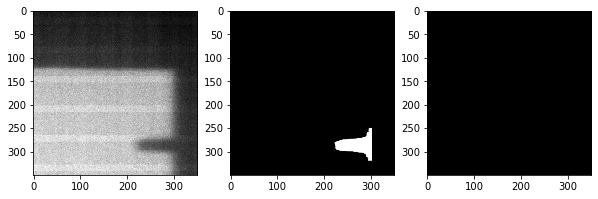

12: true_dist: 15, pred_dist: [15.102694]


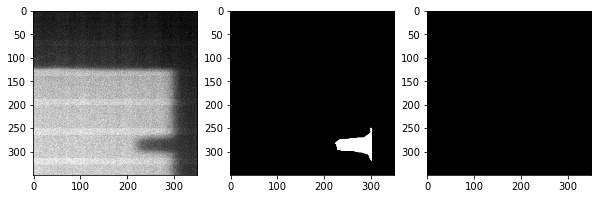

13: true_dist: 15, pred_dist: [15.320594]


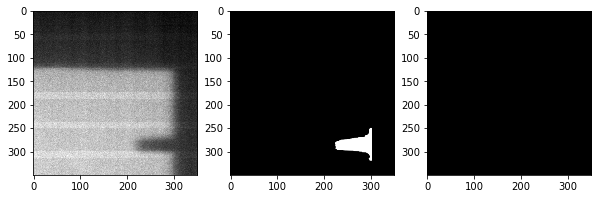

14: true_dist: 15, pred_dist: [14.874153]


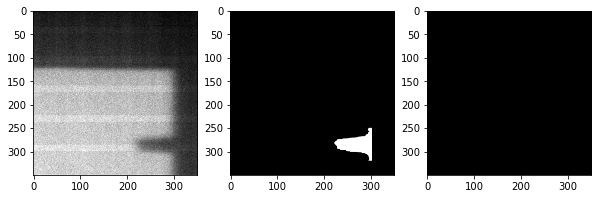

15: true_dist: 15, pred_dist: [15.206407]


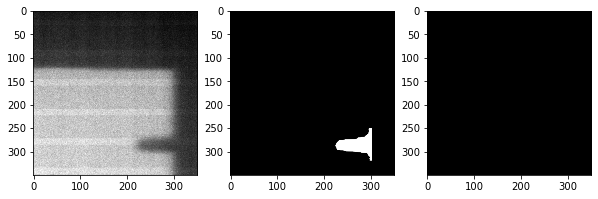

16: true_dist: 15, pred_dist: [15.03927]


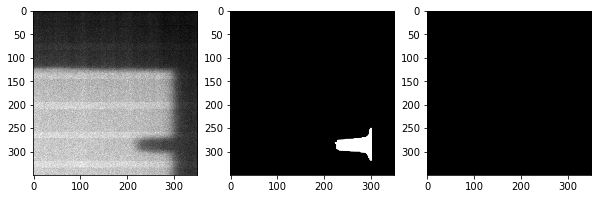

Trained_rUNet_pytorch_6positions_dataset_130epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [15.283237]


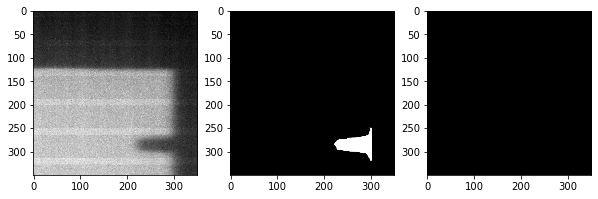

2: true_dist: 15, pred_dist: [15.423326]


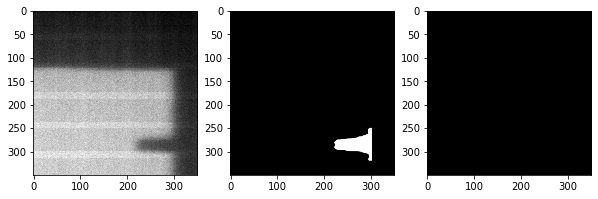

3: true_dist: 15, pred_dist: [15.101297]


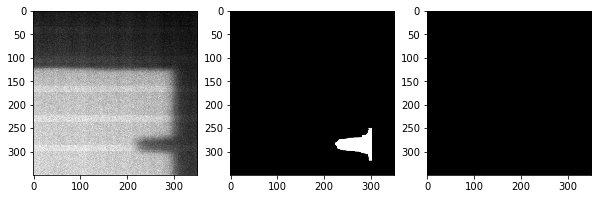

4: true_dist: 15, pred_dist: [15.223731]


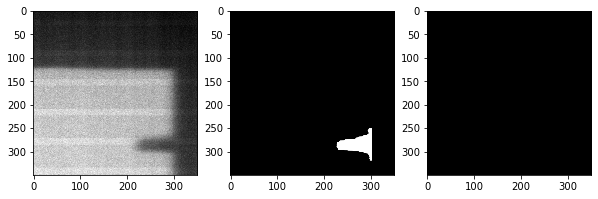

5: true_dist: 15, pred_dist: [15.124204]


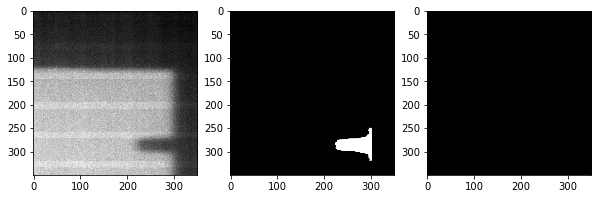

6: true_dist: 15, pred_dist: [15.360473]


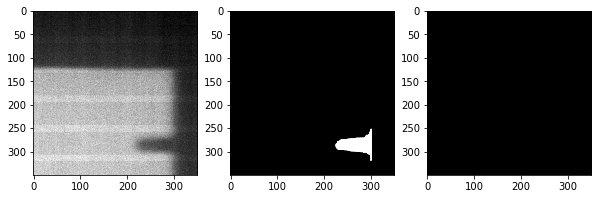

7: true_dist: 15, pred_dist: [15.194415]


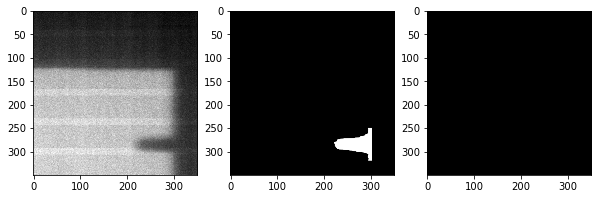

8: true_dist: 15, pred_dist: [15.190255]


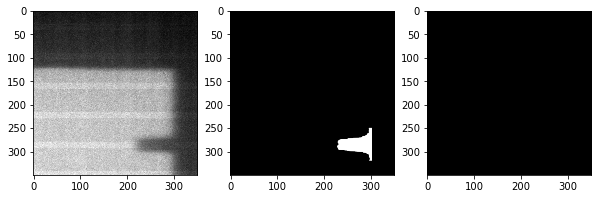

9: true_dist: 15, pred_dist: [15.186189]


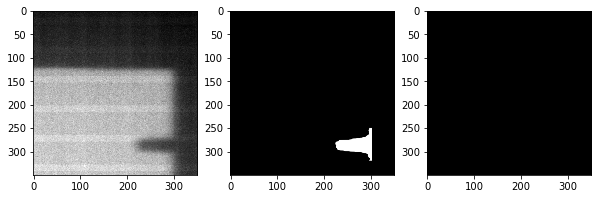

10: true_dist: 15, pred_dist: [15.443628]


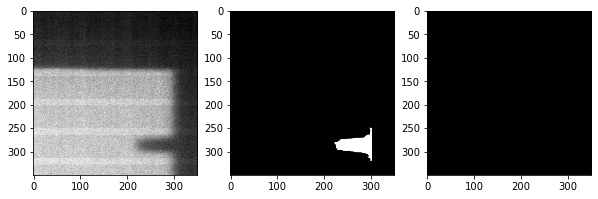

11: true_dist: 15, pred_dist: [15.4488735]


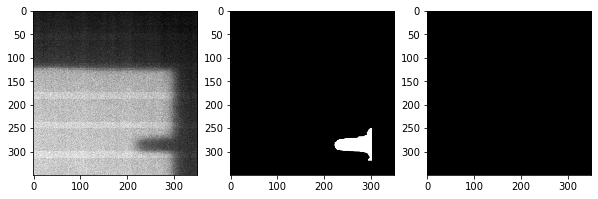

12: true_dist: 15, pred_dist: [15.146226]


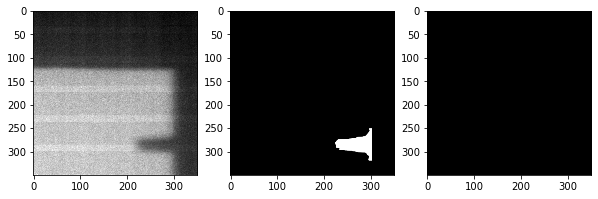

13: true_dist: 15, pred_dist: [15.451713]


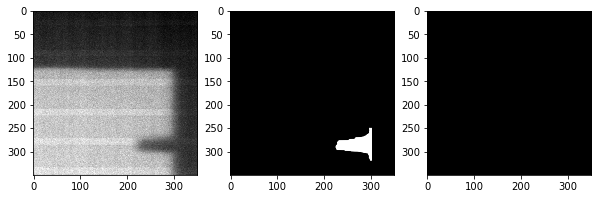

14: true_dist: 15, pred_dist: [15.316816]


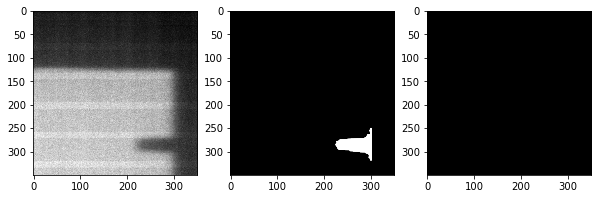

15: true_dist: 15, pred_dist: [15.392674]


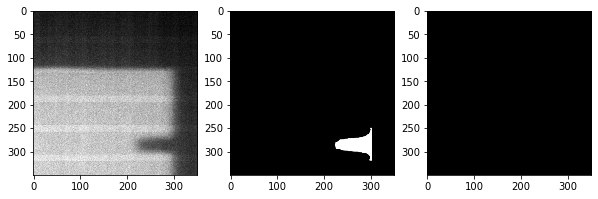

16: true_dist: 15, pred_dist: [15.211151]


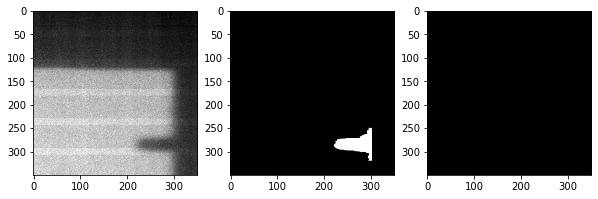

batch 2
1: true_dist: 15, pred_dist: [15.223572]


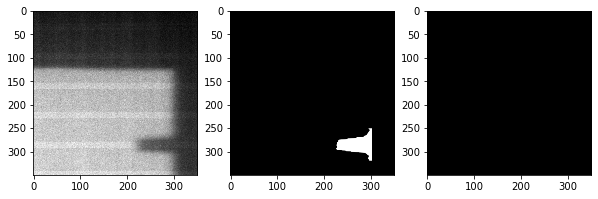

2: true_dist: 15, pred_dist: [15.264905]


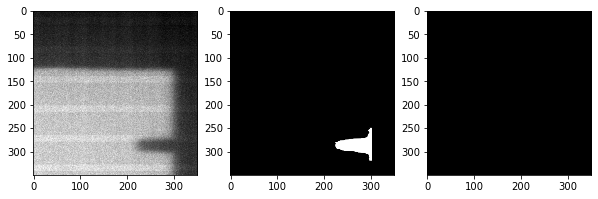

3: true_dist: 15, pred_dist: [15.349513]


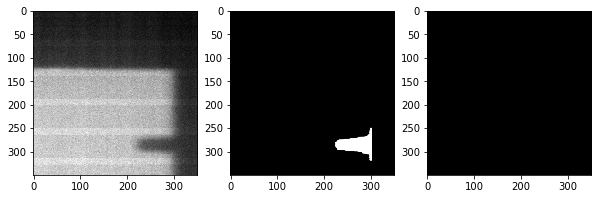

4: true_dist: 15, pred_dist: [15.389338]


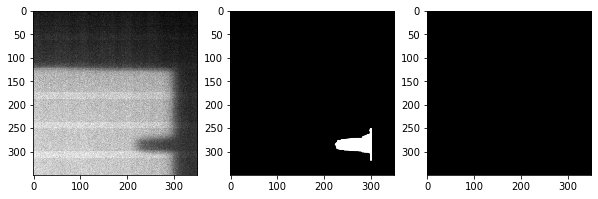

5: true_dist: 15, pred_dist: [15.085157]


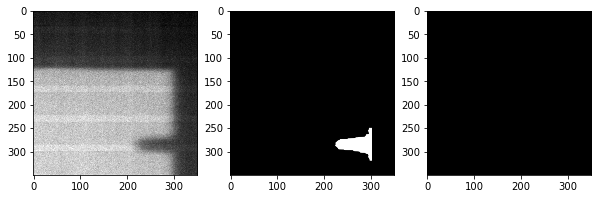

6: true_dist: 15, pred_dist: [15.397023]


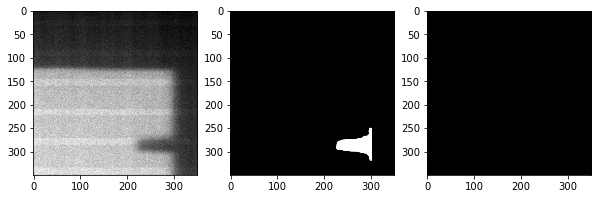

7: true_dist: 15, pred_dist: [15.211155]


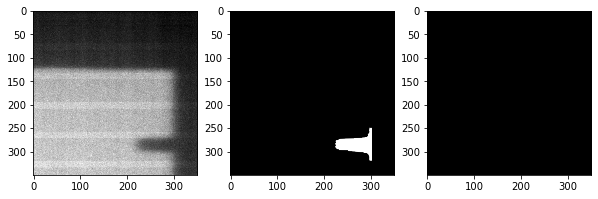

8: true_dist: 15, pred_dist: [15.32668]


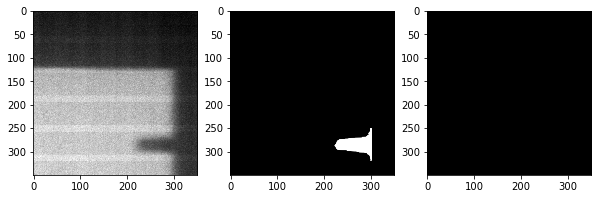

9: true_dist: 15, pred_dist: [15.013172]


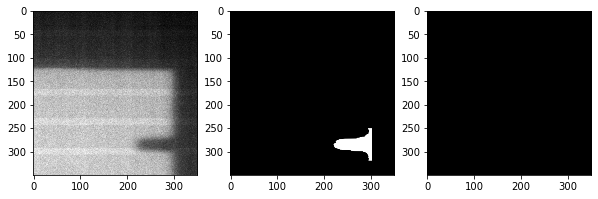

10: true_dist: 15, pred_dist: [15.134114]


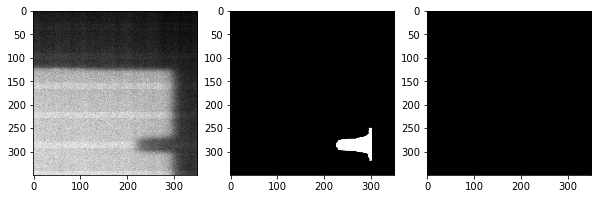

11: true_dist: 15, pred_dist: [15.17571]


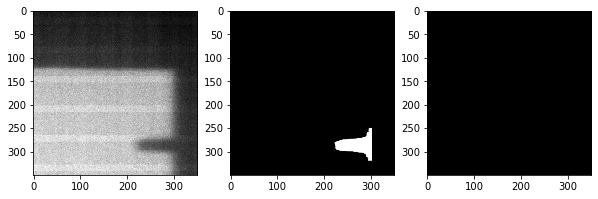

12: true_dist: 15, pred_dist: [15.330498]


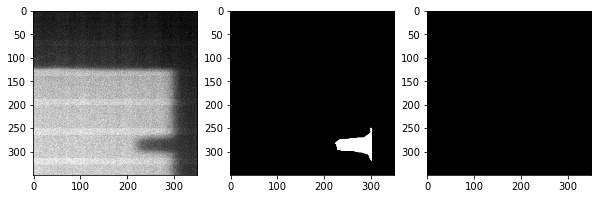

13: true_dist: 15, pred_dist: [15.408026]


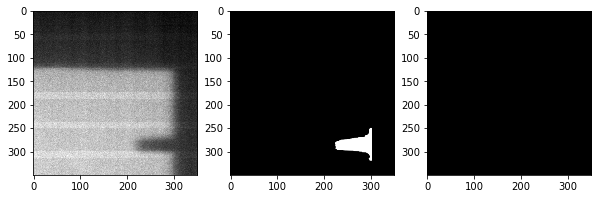

14: true_dist: 15, pred_dist: [15.09805]


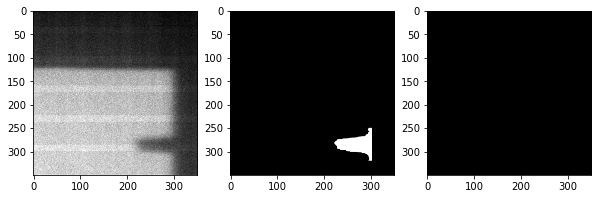

15: true_dist: 15, pred_dist: [15.27221]


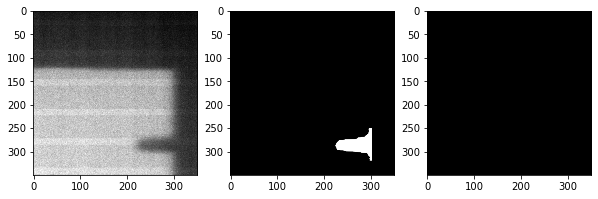

16: true_dist: 15, pred_dist: [15.117695]


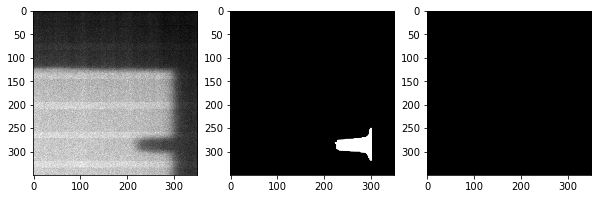

Trained_rUNet_pytorch_6positions_dataset_140epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: true_dist: 15, pred_dist: [15.312537]


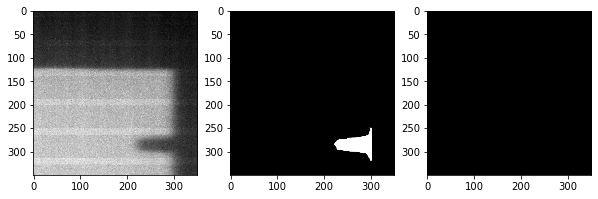

2: true_dist: 15, pred_dist: [15.4243]


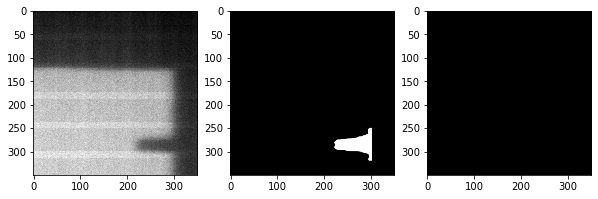

3: true_dist: 15, pred_dist: [15.243923]


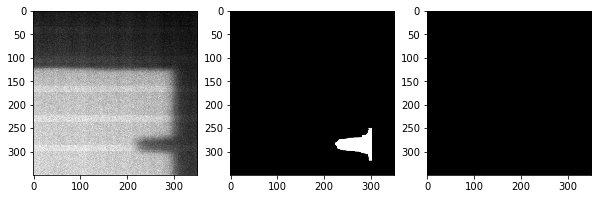

4: true_dist: 15, pred_dist: [15.25904]


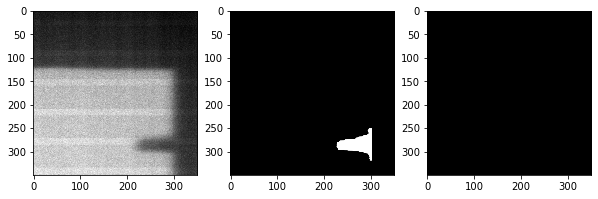

5: true_dist: 15, pred_dist: [15.088139]


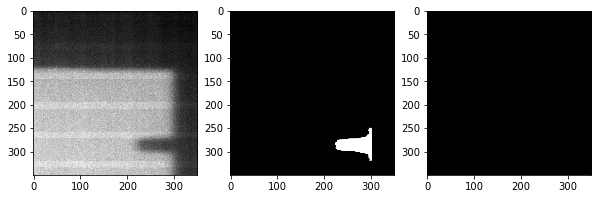

6: true_dist: 15, pred_dist: [15.447282]


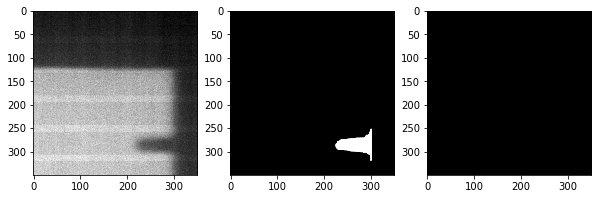

7: true_dist: 15, pred_dist: [15.253165]


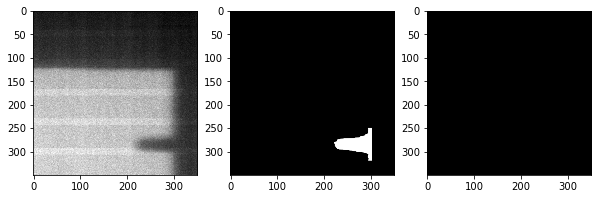

8: true_dist: 15, pred_dist: [15.303121]


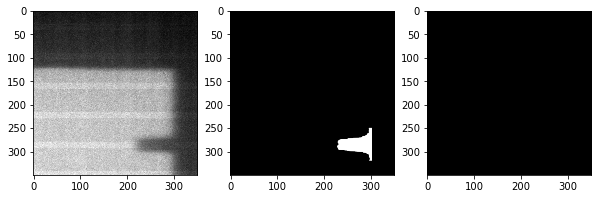

9: true_dist: 15, pred_dist: [15.154968]


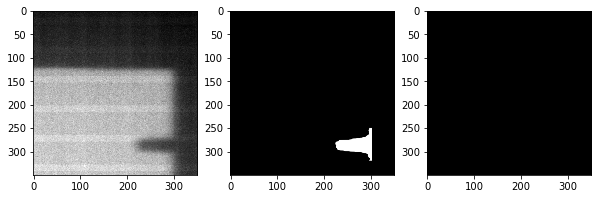

10: true_dist: 15, pred_dist: [15.500443]


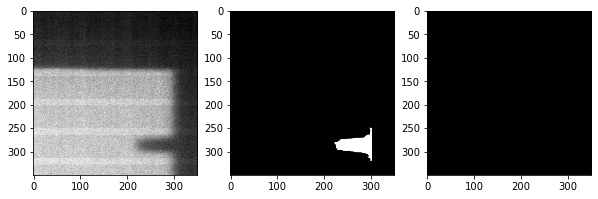

11: true_dist: 15, pred_dist: [15.437872]


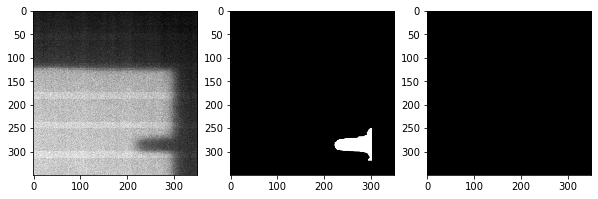

12: true_dist: 15, pred_dist: [15.302163]


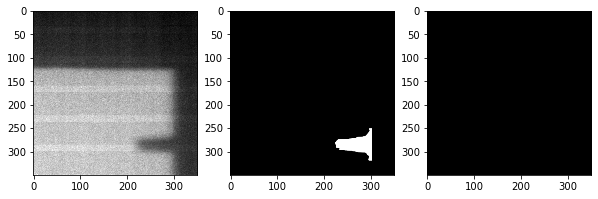

13: true_dist: 15, pred_dist: [15.48672]


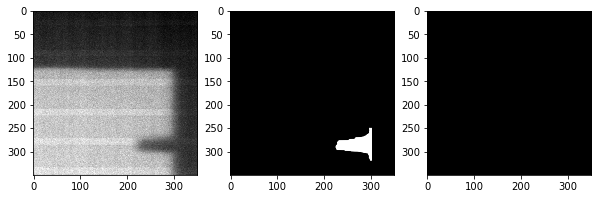

14: true_dist: 15, pred_dist: [15.247935]


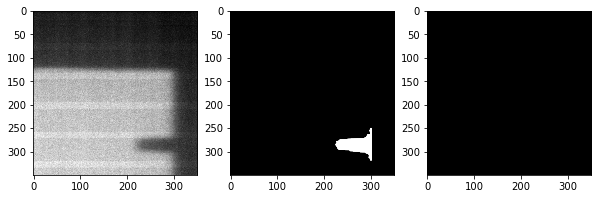

15: true_dist: 15, pred_dist: [15.463022]


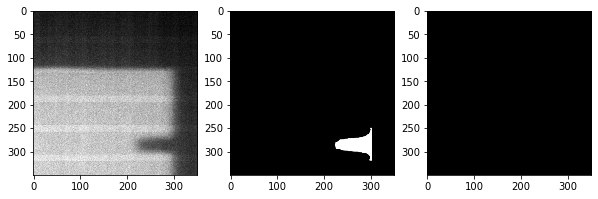

16: true_dist: 15, pred_dist: [15.2894125]


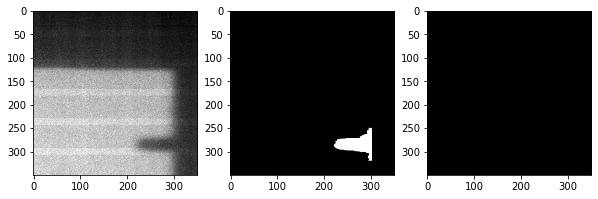

batch 2
1: true_dist: 15, pred_dist: [15.376989]


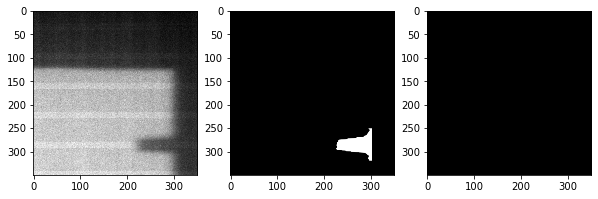

2: true_dist: 15, pred_dist: [15.191785]


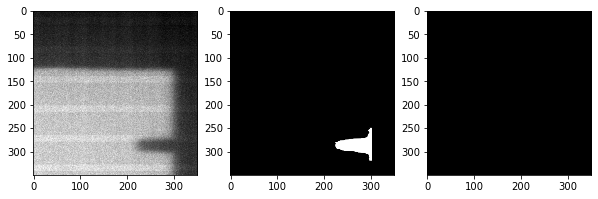

3: true_dist: 15, pred_dist: [15.389148]


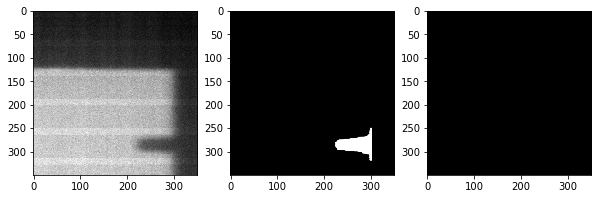

4: true_dist: 15, pred_dist: [15.386177]


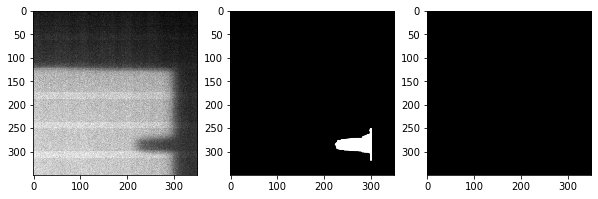

5: true_dist: 15, pred_dist: [15.218026]


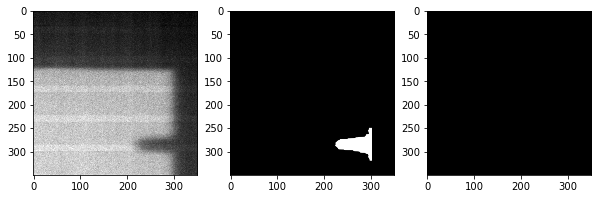

6: true_dist: 15, pred_dist: [15.443556]


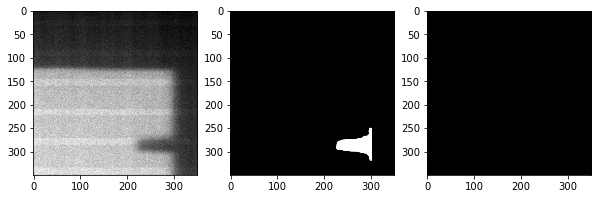

7: true_dist: 15, pred_dist: [15.17573]


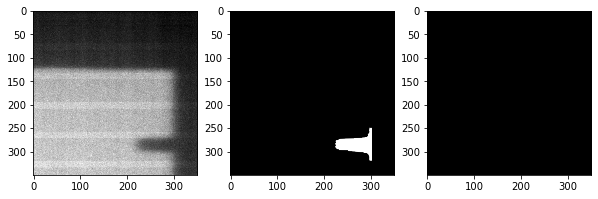

8: true_dist: 15, pred_dist: [15.378847]


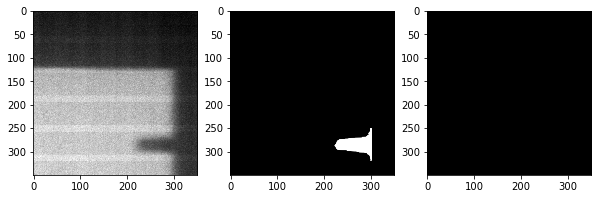

9: true_dist: 15, pred_dist: [15.083618]


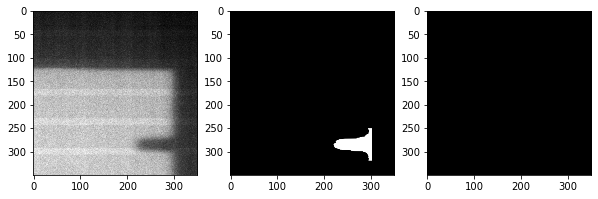

10: true_dist: 15, pred_dist: [15.24315]


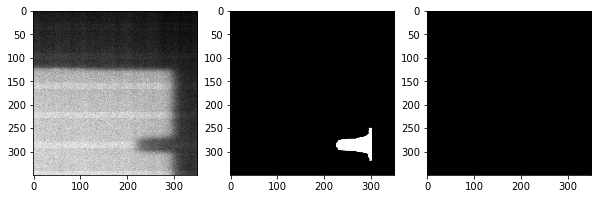

11: true_dist: 15, pred_dist: [15.118143]


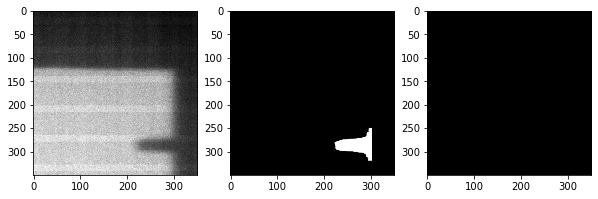

12: true_dist: 15, pred_dist: [15.380411]


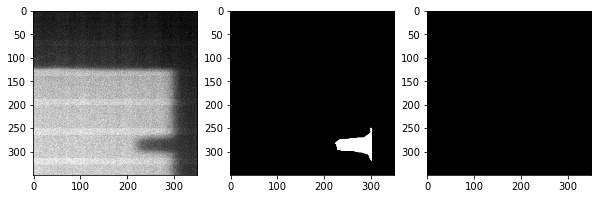

13: true_dist: 15, pred_dist: [15.406821]


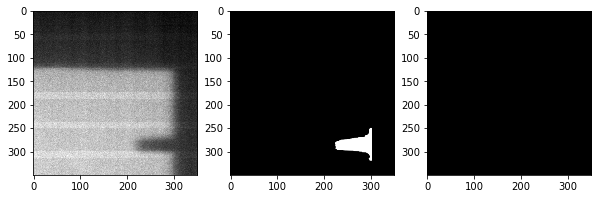

14: true_dist: 15, pred_dist: [15.26696]


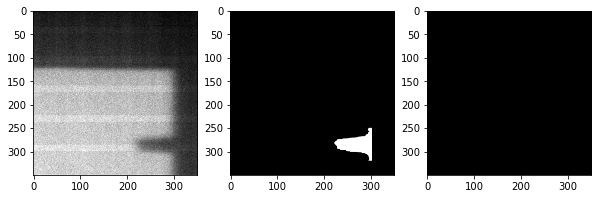

15: true_dist: 15, pred_dist: [15.297838]


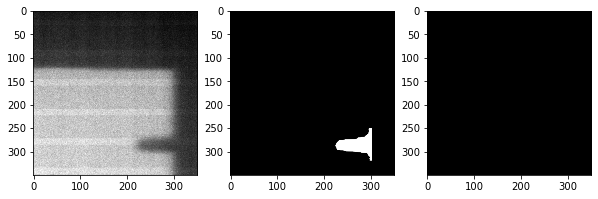

16: true_dist: 15, pred_dist: [15.079596]


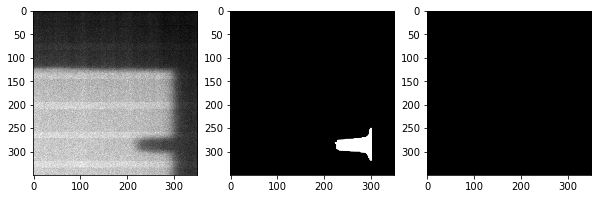

In [99]:
for epoch in np.arange(110, 150, 10):
    predict_coef_epoch(4, epoch)

---

In [106]:
data_folder_multi = '/storage/yw18581/data/v2_avg/top_right/'

In [107]:
excluded = []

In [108]:
base_transformers_3 = [Crop(row_slice=slice(0,1400), col_slice=slice(1000,None)), GaussianNoise(p=0.75, 
                                                                                                sigma=20),
                           Rescale(scale=0.25), ChannelsFirst(),ToTensor()]

In [109]:
data_loaders, data_length = define_dataset(root_folder=data_folder_multi, base_transformers=base_transformers_3,
                                           train_transformers=base_transformers_3,
                                           batch_size=16, excluded_list=excluded,
                                            alldata=True, multi_processing=4, load_mask=False)

In [110]:
def inference_phase_rUNet_plot_notebook(model, data_loaders, data_lengths, batch_size, stop=1, dev=0, test=True):
    from tqdm.notebook import tqdm
    import matplotlib.pyplot as plt

    device = torch.device("cuda:{}".format(dev) if torch.cuda.is_available() else "cpu")
    # model = cUNet(out_size=1)

    # model.load_state_dict(torch.load(model_name))
    model.eval()
    model.to(device);
    for i, batch in tqdm(enumerate(data_loaders), total=data_lengths // batch_size,
                     desc="Batch"):

        true_images = batch["image"]
        pred_masks, pred_dists = model(true_images.float().to(device))
        print("batch {}".format(i + 1))
        for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images,
                                                                        pred_masks.cpu().detach().numpy(),
                                                                        pred_dists.cpu().detach().numpy())):
            print("{}: pred_dist: {}".format(j + 1, pr_dist))

            f = plt.figure(figsize=(10, 5))
            f.add_subplot(1, 2, 1)
            plt.imshow(img[0, ...], cmap='gray')
            f.add_subplot(1, 2, 2)
            plt.imshow(pr_msk[0, ...], cmap='gray')
            plt.show(block=True)

        if i == stop:
            break

Trained_rUNet_pytorch_6positions_dataset_130epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: pred_dist: [6.2301254]


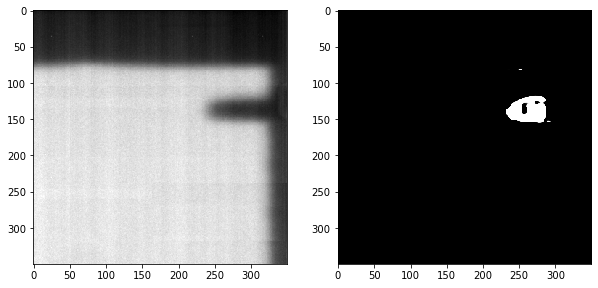

2: pred_dist: [80.675606]


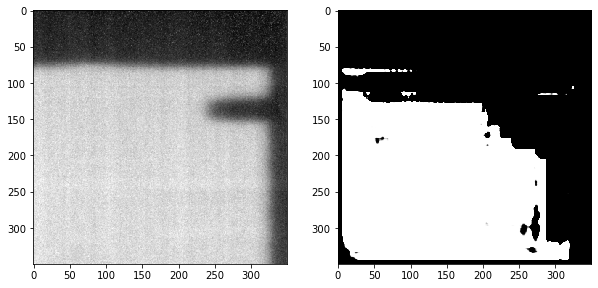

3: pred_dist: [93.4286]


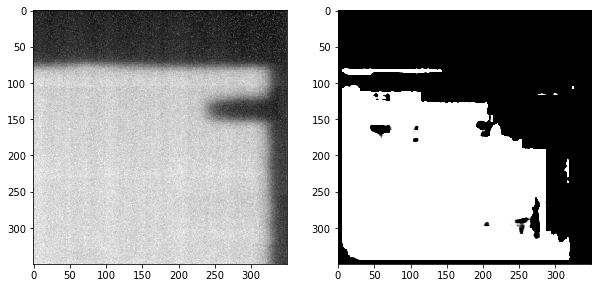

4: pred_dist: [6.264197]


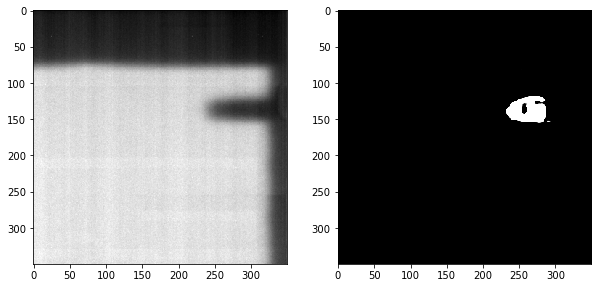

5: pred_dist: [131.63806]


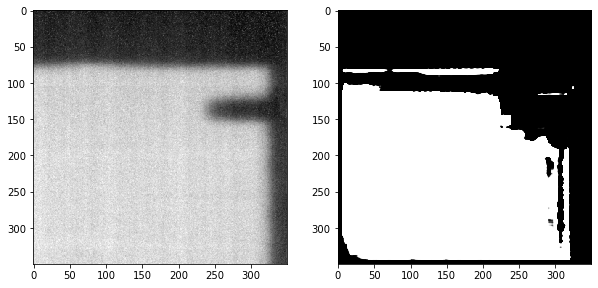

6: pred_dist: [130.74417]


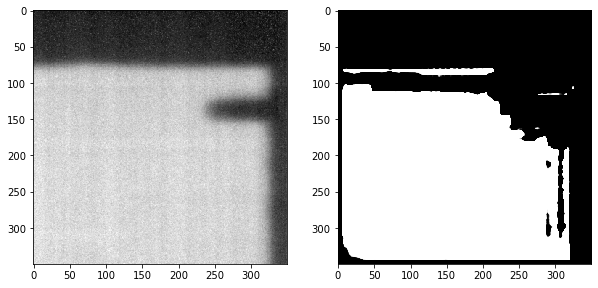

7: pred_dist: [20.342438]


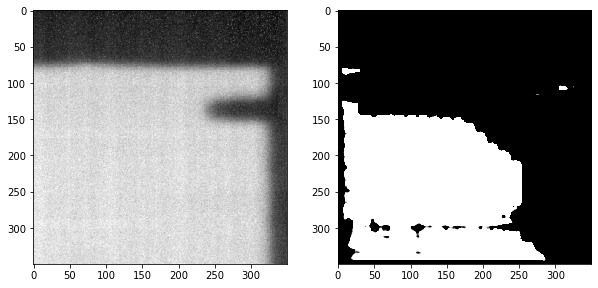

8: pred_dist: [6.2036366]


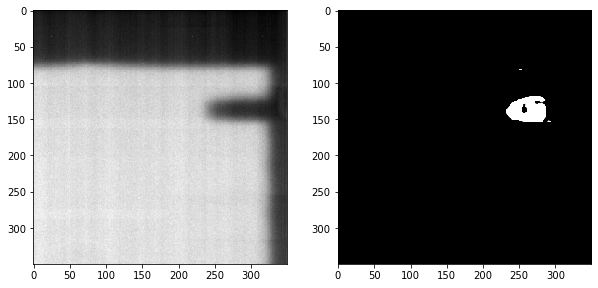

9: pred_dist: [6.167701]


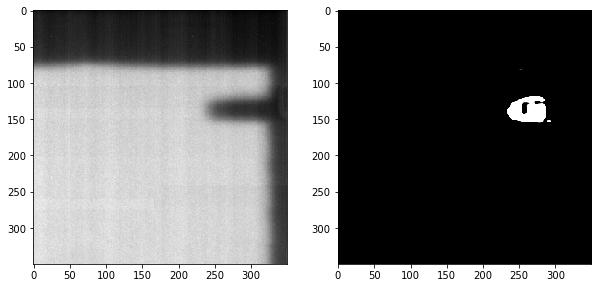

10: pred_dist: [79.95525]


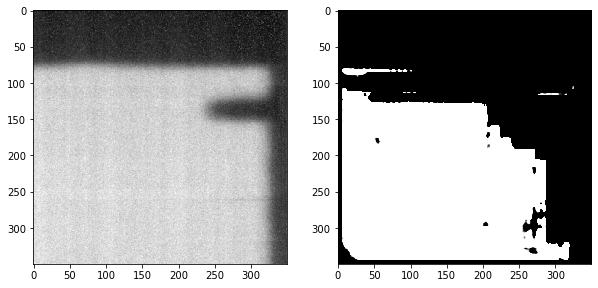

11: pred_dist: [109.58698]


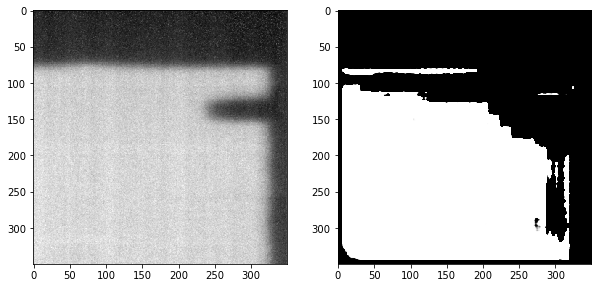

12: pred_dist: [121.73717]


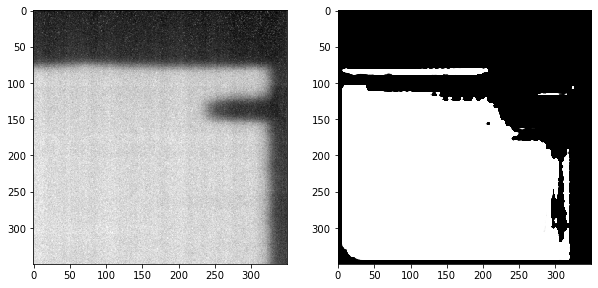

13: pred_dist: [133.84503]


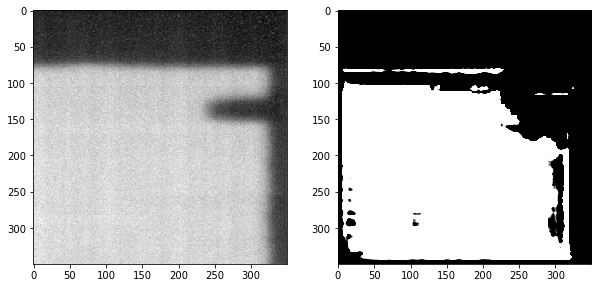

14: pred_dist: [123.74899]


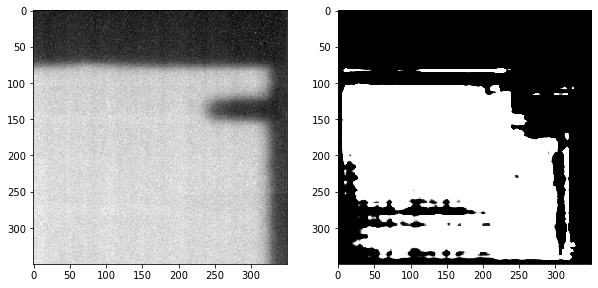

15: pred_dist: [21.71957]


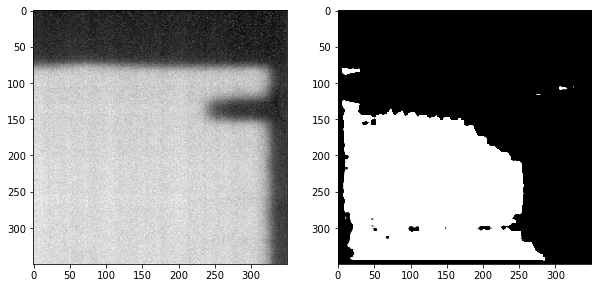

16: pred_dist: [70.24934]


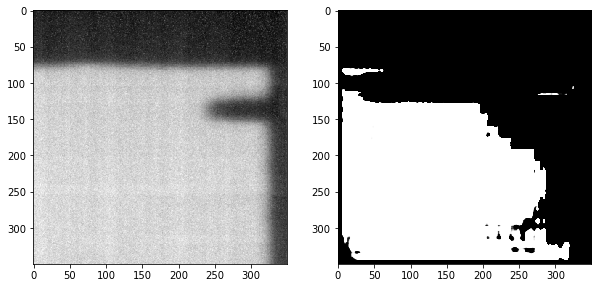

batch 2
1: pred_dist: [6.23077]


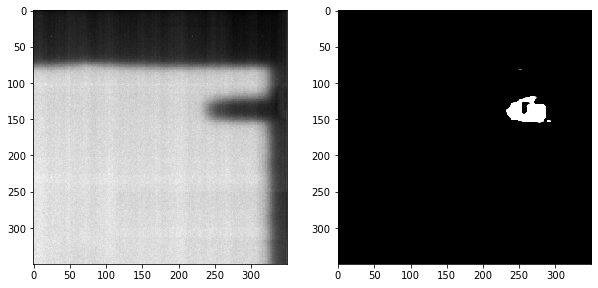

2: pred_dist: [91.47925]


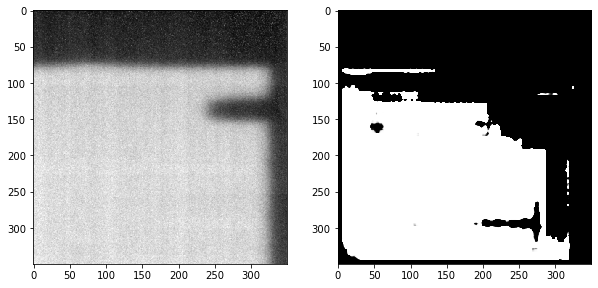

3: pred_dist: [102.62606]


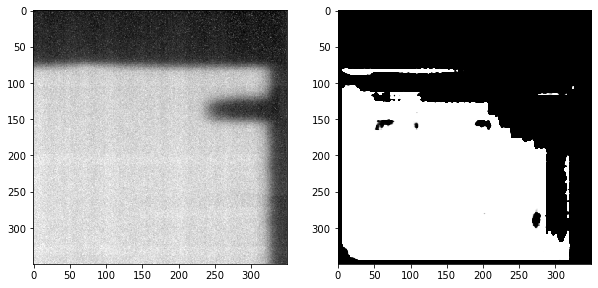

4: pred_dist: [6.29731]


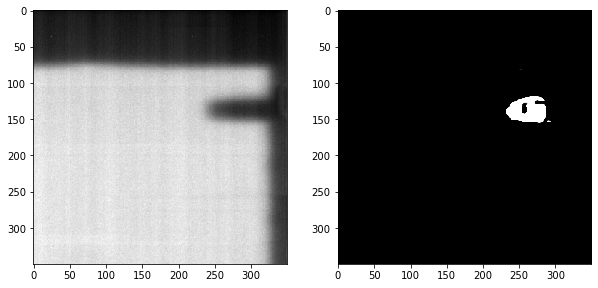

5: pred_dist: [133.30682]


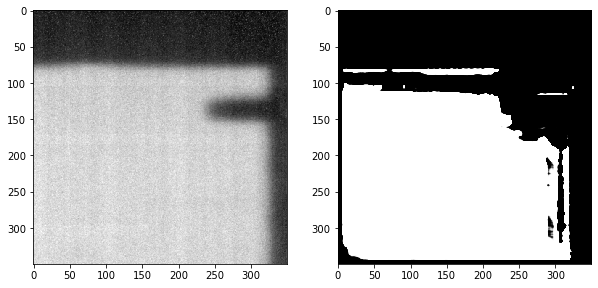

6: pred_dist: [132.67728]


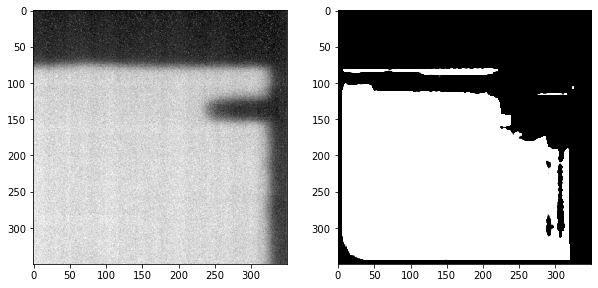

7: pred_dist: [19.553614]


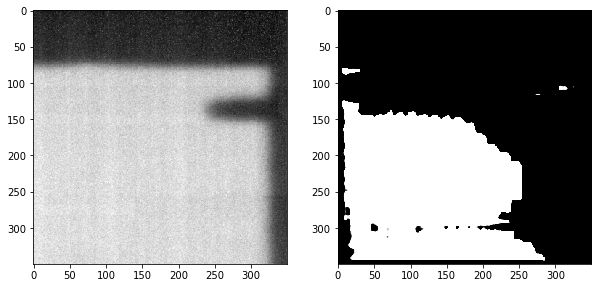

8: pred_dist: [6.2810183]


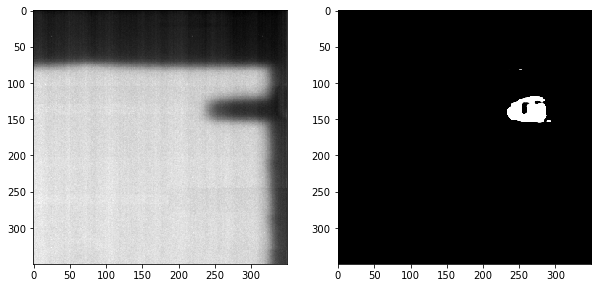

9: pred_dist: [6.232363]


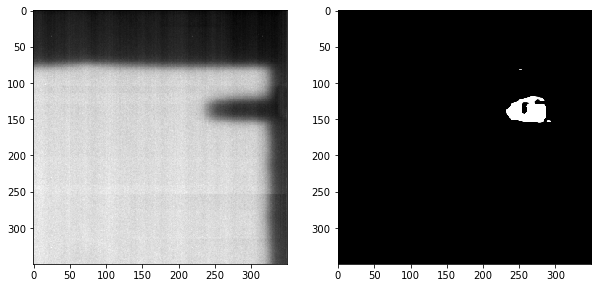

10: pred_dist: [93.365906]


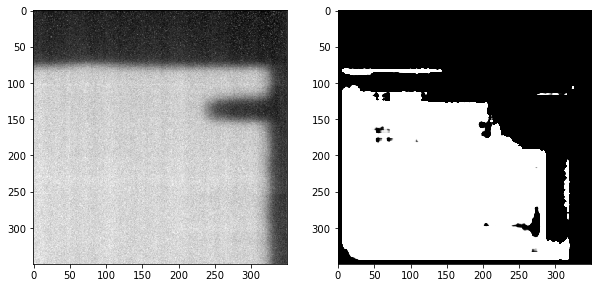

11: pred_dist: [103.34677]


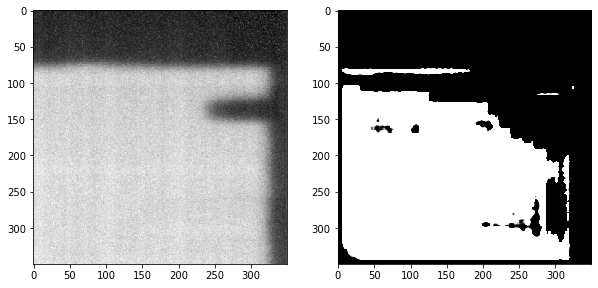

12: pred_dist: [122.65084]


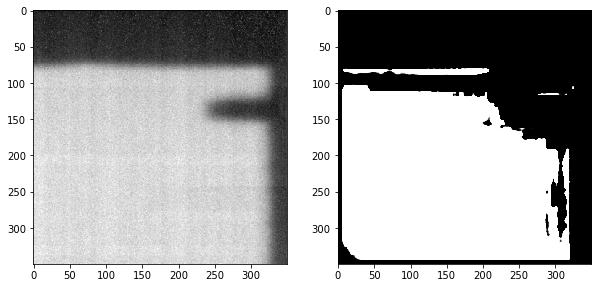

13: pred_dist: [131.7579]


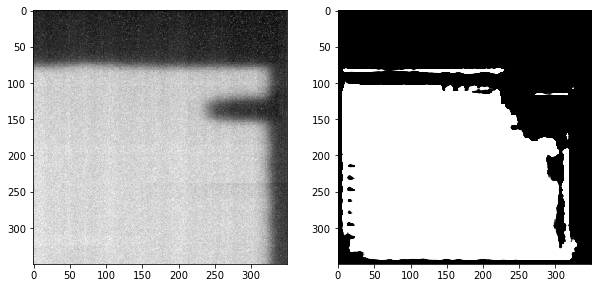

14: pred_dist: [95.04985]


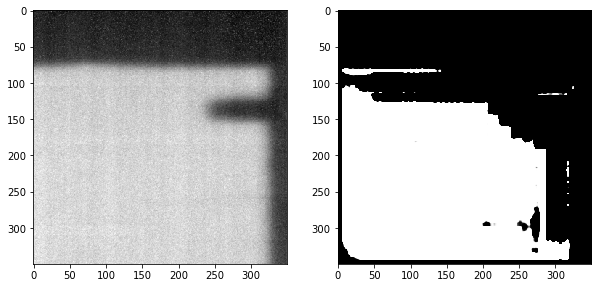

In [111]:
predict_coef_epoch(4,130)

---

In [112]:
demonstrator = '/storage/yw18581/data/demonstrator/'

In [23]:
base_transformers_dem8 = [Crop(row_slice=slice(0,1400), col_slice=slice(0,1400)),
                    Rescale(scale=0.25),  
                     ChannelsFirst(), ToTensor()]

In [25]:
data_loaders, data_length = define_dataset(root_folder=demonstrator, 
                                           base_transformers=base_transformers_dem8,
                                           train_transformers=base_transformers_dem8,
                                           batch_size=1, file_extension='.tif',
                                           fname_key='m0008',
                                            alldata=True, multi_processing=4, load_mask=False)

torch.Size([1, 1, 350, 350])
torch.Size([1, 1, 350, 350])


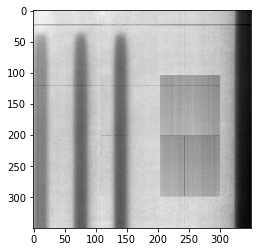

In [26]:
for batch in data_loaders:
    img = batch['image']
    
    print(img.shape)
    plt.imshow(img[0,0,...], cmap='gray')

In [31]:
def predict_coef_epoch(coeff, epoch):
    filelist, epochs = get_fnames(coeff)
    model_fname = filelist[int(np.argwhere(epochs==epoch)[0])]
    print(model_fname)
    torch.cuda.empty_cache()
    model = rUNet(out_size=1)
    checkpoint = torch.load(root_path(model_fname))['model_state_dict']
    #print(checkpoint)
    model.load_state_dict(checkpoint)
    
    print('Checkpoint loaded')
    inference_phase_rUNet_plot_notebook(model, data_loaders, data_length,
                                       batch_size=1, stop=None, test=False)

    return

Trained_rUNet_pytorch_6positions_dataset_150epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: pred_dist: [3.733424]


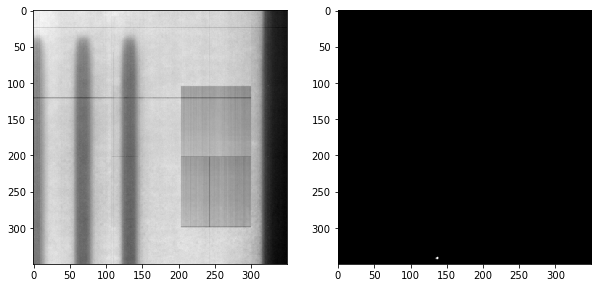

batch 2
1: pred_dist: [5.8599663]


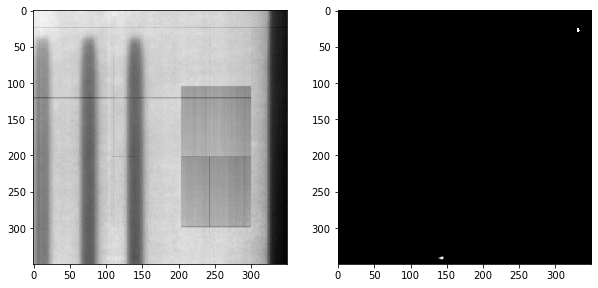

In [64]:
predict_coef_epoch(4,150)

In [113]:
base_transformers_dem6 = [Crop(row_slice=slice(0,700), col_slice=slice(1700,None)),
                    Rescale(scale=0.5), GaussianNoise(p=0.75, sigma=2, mean=30),
                     ChannelsFirst(), ToTensor()]
data_loaders, data_length = define_dataset(root_folder=demonstrator, 
                                           base_transformers=base_transformers_dem6,
                                           train_transformers=base_transformers_dem6,
                                           batch_size=1, file_extension='.tif',
                                           fname_key='m0006',
                                            alldata=True, multi_processing=4, load_mask=False)

torch.Size([1, 1, 350, 350])
torch.Size([1, 1, 350, 350])


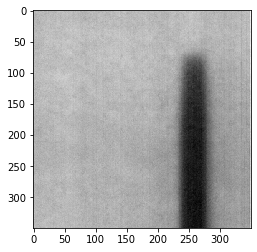

In [114]:
for batch in data_loaders:
    img = batch['image']
    
    print(img.shape)
    plt.imshow(img[0,0,...], cmap='gray')

Trained_rUNet_pytorch_6positions_dataset_130epochs_0.4coeff_mask.pkl
Checkpoint loaded


batch 1
1: pred_dist: [1.073378]


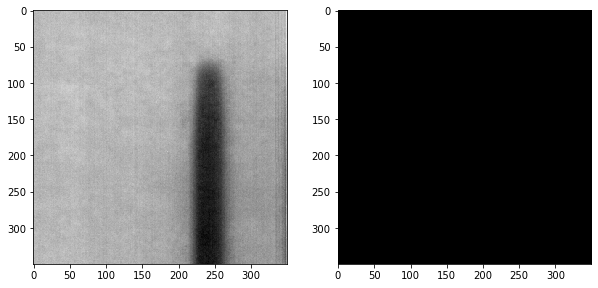

batch 2
1: pred_dist: [1.0678041]


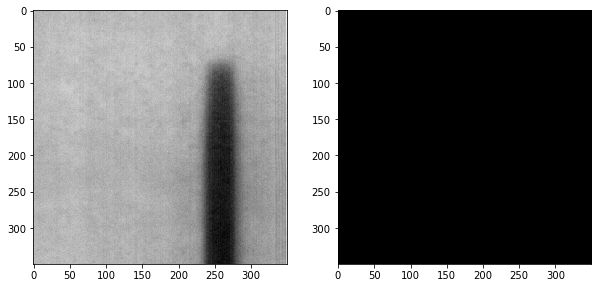

In [115]:
predict_coef_epoch(4,130)

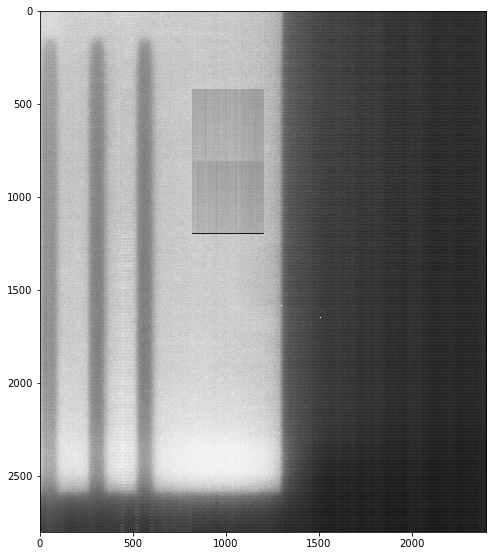

In [72]:
plt.figure(figsize=(8,10))
plt.imshow(plt.imread(os.path.join(demonstrator, 'm0008_50frames_68_9.tif')),cmap='gray')